# Enhanced Parking Lot Segmentation Model with Evaluation Pipeline

In [76]:
import os
import numpy as np
from PIL import Image
from tqdm.notebook import tqdm
from transformers import AutoImageProcessor, AutoModelForSemanticSegmentation
from datasets import Dataset, load_dataset
import torch
from torch.utils.data import DataLoader
from transformers import TrainingArguments
from transformers import Trainer
from transformers import logging as hf_logging
import evaluate
import torch.nn.functional as F
import gc
from torchmetrics.classification import MulticlassAccuracy, MulticlassF1Score, MulticlassJaccardIndex

# Create a mock sctypes dictionary
np.sctypes = {
    "float": [np.float16, np.float32, np.float64],
    "int": [np.int8, np.int16, np.int32, np.int64],
    "uint": [np.uint8, np.uint16, np.uint32, np.uint64],
    "complex": [np.complex64, np.complex128]
}
import imgaug as ia

# NEW IMPORTS FOR EVALUATION PIPELINE
import json
import matplotlib.pyplot as plt
import pandas as pd
from datetime import datetime
from dataclasses import dataclass, asdict
from typing import Dict, List, Any, Optional, Tuple
import seaborn as sns
from sklearn.metrics import confusion_matrix
import itertools
from transformers import TrainerCallback
# import wandb  # Optional: uncomment if you want to use wandb

In [77]:
input_path = "/home/ubuntu/CS231N/APKLOT_original"
output_path = "/home/ubuntu/CS231N/outputs_enhanced"
os.makedirs(output_path, exist_ok=True)
print(f"Results will be saved to: {output_path}")

Results will be saved to: /home/ubuntu/CS231N/outputs_enhanced


In [78]:
import torch
print("CUDA available:", torch.cuda.is_available())
if torch.cuda.is_available():
    print("Device:", torch.cuda.get_device_name(0))

CUDA available: True
Device: NVIDIA A10


In [79]:
NUM_PROC = 15
CHECKPOINT = "nvidia/segformer-b0-finetuned-ade-512-512"

# Helper Functions

## Data processing

In [80]:
def audit_data(ds, amt=1000):
    ds_copy = ds.select(range(amt))
    
    bad_image_count = 0
    bad_mask_count = 0
    i = 0
    for ex in ds_copy:
        img = ex.get("image")
        msk = ex.get("mask")
    
        is_bad_image = not isinstance(img, Image.Image)
        is_bad_mask = not isinstance(msk, Image.Image)
    
        if is_bad_image:
            bad_image_count += 1
        if is_bad_mask:
            bad_mask_count += 1
        if i % 100 == 0:
            print(i)
        i += 1
    
    print(f"Bad images: {bad_image_count} / {amt}")
    print(f"Bad masks: {bad_mask_count} / {amt}")

In [81]:
def fetch_and_open(example):
    try:
        img = Image.open(example["image"]).convert("RGB")
        msk = Image.open(example["mask"]).convert("L")
        return {"image": img, "mask": msk}
    except Exception:
        return {}

In [82]:
def show_image(image, mask, color=(255,0,0), alpha=0.5):
    image = image.convert("RGBA")
    mask = mask.convert("L")
    colored_mask = Image.new("RGBA", image.size, color + (0,))
    def make_alpha(p):
        return int((p > 0) * 255 * alpha)
    alpha_channel = mask.point(make_alpha)
    colored_mask.putalpha(alpha_channel)
    return Image.alpha_composite(image, colored_mask)

In [83]:
def is_valid_example(example):
    img = example.get("image", None)
    msk = example.get("mask", None)
    
    if not isinstance(img, Image.Image):
        return False
    if not isinstance(msk, Image.Image):
        return False

    return True

## Evaluation Pipeline

In [84]:
@dataclass
class ExperimentConfig:
    experiment_name: str
    model_checkpoint: str = "nvidia/segformer-b0-finetuned-ade-512-512"
    
    # Training hyperparameters
    learning_rate: float = 1e-5
    per_device_train_batch_size: int = 8
    per_device_eval_batch_size: int = 2
    num_train_epochs: int = 3
    warmup_steps: int = 500
    weight_decay: float = 0.01
    
    # Training configuration
    gradient_accumulation_steps: int = 1
    eval_accumulation_steps: int = 10
    save_steps: int = 1000
    eval_steps: int = 1000
    logging_steps: int = 100
    
    # Data configuration
    train_data_fraction: float = 1.0  # Use subset for quick experiments
    eval_data_fraction: float = 1.0
    
    def to_dict(self):
        return asdict(self)

In [85]:
class ExperimentTracker:
    def __init__(self, base_output_dir: str):
        self.base_output_dir = base_output_dir
        self.results_file = os.path.join(base_output_dir, "experiment_results.json")
        print(f"Loading from {self.results_file}")
        self.results = self.load_results()
    
    def load_results(self) -> List[Dict]:
        if os.path.exists(self.results_file):
            with open(self.results_file, 'r') as f:
                return json.load(f)
        return []
    
    def save_experiment(self, config: ExperimentConfig, metrics: Dict[str, Any], 
                       model_path: str, training_history: List[Dict]):
        experiment = {
            "timestamp": datetime.now().isoformat(),
            "experiment_name": config.experiment_name,
            "config": config.to_dict(),
            "final_metrics": metrics,
            "model_path": model_path,
            "training_history": training_history
        }
        
        self.results.append(experiment)
        
        # Save to file
        os.makedirs(self.base_output_dir, exist_ok=True)
        with open(self.results_file, 'w') as f:
            json.dump(self.results, f, indent=2)
        
        print(f"Experiment '{config.experiment_name}' saved!")
    
    def get_best_experiment(self, metric: str = "eval_accuracy") -> Optional[Dict]:
        if not self.results:
            return None
        
        best = max(self.results, 
                  key=lambda x: x.get("final_metrics", {}).get(metric, 0))
        return best
    
    def compare_experiments(self, metric: str = "eval_accuracy") -> pd.DataFrame:
        if not self.results:
            return pd.DataFrame()
        
        data = []
        for exp in self.results:
            row = {
                "experiment_name": exp["experiment_name"],
                "timestamp": exp["timestamp"],
                **exp["config"],
                **exp.get("final_metrics", {})
            }
            data.append(row)
        
        return pd.DataFrame(data)

In [86]:
class MetricsTracker(TrainerCallback):
    def __init__(self):
        self.training_history = []
        self.current_epoch_logs = {}
    
    def on_log(self, args, state, control, model=None, logs=None, **kwargs):
        """Called when trainer logs metrics"""
        if logs:
            # Normalize training loss key
            logs = logs.copy()
            if "loss" in logs and "train_loss" not in logs:
                logs["train_loss"] = logs.pop("loss")
                
            step_log = {
                "step": state.global_step,
                "epoch": state.epoch,
                **logs
            }
            self.training_history.append(step_log)

    def on_evaluate(self, args, state, control, metrics=None, **kwargs):
        """Called during evaluation to log eval metrics."""
        if metrics:
            eval_log = {
                "step": state.global_step,
                "epoch": state.epoch,
                **metrics
            }
            self.training_history.append(eval_log)
    
    def get_history_df(self) -> pd.DataFrame:
        """Get training history as DataFrame"""
        return pd.DataFrame(self.training_history)

## Visualization functions

In [87]:
def plot_training_curves(history_df: pd.DataFrame, save_path: Optional[str] = None):
    """Plot training and validation curves"""
    fig, axes = plt.subplots(2, 2, figsize=(15, 10))
    fig.suptitle('Training Progress', fontsize=16)
    
    # Loss curves
    train_loss = history_df[history_df['train_loss'].notna()]
    eval_loss = history_df[history_df['eval_loss'].notna()]
    
    axes[0, 0].plot(train_loss['step'], train_loss['train_loss'], 
                    label='Train Loss', alpha=0.7)
    axes[0, 0].plot(eval_loss['step'], eval_loss['eval_loss'], 
                    label='Eval Loss', alpha=0.7)
    axes[0, 0].set_xlabel('Steps')
    axes[0, 0].set_ylabel('Loss')
    axes[0, 0].set_title('Loss Curves')
    axes[0, 0].legend()
    axes[0, 0].grid(True, alpha=0.3)
    
    # Accuracy curves
    eval_acc = history_df[history_df['eval_accuracy'].notna()]
    axes[0, 1].plot(eval_acc['step'], eval_acc['eval_accuracy'], 
                    label='Eval Accuracy', color='orange', alpha=0.7)
    axes[0, 1].set_xlabel('Steps')
    axes[0, 1].set_ylabel('Accuracy')
    axes[0, 1].set_title('Accuracy Curve')
    axes[0, 1].legend()
    axes[0, 1].grid(True, alpha=0.3)
    
    # IoU curves
    eval_iou = history_df[history_df['eval_iou'].notna()]
    axes[1, 0].plot(eval_iou['step'], eval_iou['eval_iou'], 
                    label='Overall IoU', color='green', alpha=0.7)
    if 'eval_iou_parking' in history_df.columns:
        eval_iou_parking = history_df[history_df['eval_iou_parking'].notna()]
        axes[1, 0].plot(eval_iou_parking['step'], eval_iou_parking['eval_iou_parking'], 
                        label='Parking IoU', color='red', alpha=0.7)
    axes[1, 0].set_xlabel('Steps')
    axes[1, 0].set_ylabel('IoU')
    axes[1, 0].set_title('IoU Curves')
    axes[1, 0].legend()
    axes[1, 0].grid(True, alpha=0.3)
    
    # Learning rate (if available)
    if 'learning_rate' in history_df.columns:
        lr_data = history_df[history_df['learning_rate'].notna()]
        axes[1, 1].plot(lr_data['step'], lr_data['learning_rate'], 
                        label='Learning Rate', color='purple', alpha=0.7)
        axes[1, 1].set_xlabel('Steps')
        axes[1, 1].set_ylabel('Learning Rate')
        axes[1, 1].set_title('Learning Rate Schedule')
        axes[1, 1].legend()
        axes[1, 1].grid(True, alpha=0.3)
    else:
        axes[1, 1].text(0.5, 0.5, 'Learning Rate\nNot Available', 
                        ha='center', va='center', transform=axes[1, 1].transAxes)
    
    plt.tight_layout()
    
    if save_path:
        plt.savefig(save_path, dpi=300, bbox_inches='tight')
    
    return plt

In [88]:
def extract_results(experiments: dict, metrics: dict):
    raw_experiment_names = list(experiments.keys())
    mapped_experiment_names = list(experiments.values())
    raw_metric_names = list(metrics.keys())
    mapped_metric_names = list(metrics.values())
    df = pd.DataFrame(index=mapped_experiment_names, columns=mapped_metric_names)
    with open(os.path.join(output_path, 'experiment_results.json'), 'r') as f:
        all_results = json.load(f)
    already_done = {}
    for i in range(len(all_results)):
        # iterate through all experiments 
        these_results = all_results[i]
        this_time_stamp = these_results['timestamp']
        this_raw_name = these_results['experiment_name']

        # check if we already have this run, and existing is "newer"
        if this_raw_name in already_done:
            if pd.Timestamp(this_time_stamp) < pd.Timestamp(already_done[this_raw_name]):
                continue
        # check if this run in desired runs 
        if this_raw_name in raw_experiment_names:
            this_mapped_name = experiments[this_raw_name]
            for this_raw_metric in raw_metric_names:
                df.loc[this_mapped_name, metrics[this_raw_metric]] = these_results['final_metrics'][this_raw_metric]
            already_done[this_raw_name] = this_time_stamp
    return df

In [89]:
def plot_experiment_comparison(df, add_annotations=True, y_axis_range=(0, 1), subplot_height=5, subplot_width=6):
    """Plot comparison of different experiments"""
    metrics = list(df.columns)
    font_size=14
    tick_font_size=12
    annotation_font_size=12
    
    fig, axes = plt.subplots(1, len(metrics), figsize=(subplot_width * len(metrics), subplot_height))
    if len(metrics) == 1:
        axes = [axes]

    for i, metric in enumerate(metrics):
        if metric in df.columns:
            bars = axes[i].bar(range(len(df)), df[metric])
            axes[i].set_ylabel(metric, fontsize=font_size)
            axes[i].set_title(f"{metric} Comparison", fontsize=font_size)
            axes[i].set_xticks(range(len(df)))
            axes[i].set_xticklabels(list(df.index), rotation=45, ha='right', fontsize=font_size)
            axes[i].set_ylim(y_axis_range)
            axes[i].tick_params(axis='y', labelsize=tick_font_size)
            
            # Add value labels on bars
            if add_annotations:
                for j, bar in enumerate(bars):
                    height = bar.get_height()
                    axes[i].text(bar.get_x() + bar.get_width()/2., height,
                                 f'{height:.3f}', ha='center', va='bottom', fontsize=annotation_font_size)

    plt.tight_layout()
    return plt


In [90]:
def visualize_predictions(model, processor, test_images: List, 
                         test_masks: List = None, num_samples: int = 4):
    """Visualize model predictions on test images"""
    model.eval()
    fig, axes = plt.subplots(num_samples, 3 if test_masks else 2, 
                            figsize=(12, 4*num_samples))
    
    if num_samples == 1:
        axes = axes.reshape(1, -1)
    
    for i in range(min(num_samples, len(test_images))):
        image = test_images[i]
        
        # Preprocess image
        if test_masks:
            processed = preprocess({"image": image, "mask": test_masks[i]})
        else:
            # Create dummy mask for preprocessing
            dummy_mask = Image.new("L", image.size, color=0)
            processed = preprocess({"image": image, "mask": dummy_mask})
        
        pixel_values = processed["pixel_values"].unsqueeze(0).to(model.device)
        
        # Get prediction
        with torch.no_grad():
            outputs = model(pixel_values=pixel_values)
            logits = outputs.logits
            logits = torch.nn.functional.interpolate(
                logits, size=image.size[::-1], 
                mode="bilinear", align_corners=False
            )
            pred_mask = torch.argmax(logits, dim=1).squeeze(0).cpu().numpy()
            pred_mask_pil = Image.fromarray((pred_mask * 255).astype(np.uint8), mode="L")
        
        # Plot original image
        axes[i, 0].imshow(image)
        axes[i, 0].set_title(f'Original Image {i+1}')
        axes[i, 0].axis('off')
        
        # Plot prediction
        pred_overlay = show_image(image, pred_mask_pil, color=(255,0,0), alpha=0.4)
        axes[i, 1].imshow(pred_overlay)
        axes[i, 1].set_title(f'Prediction {i+1}')
        axes[i, 1].axis('off')
        
        # Plot ground truth if available
        if test_masks:
            gt_overlay = show_image(image, test_masks[i], color=(0,255,0), alpha=0.4)
            axes[i, 2].imshow(gt_overlay)
            axes[i, 2].set_title(f'Ground Truth {i+1}')
            axes[i, 2].axis('off')
    
    plt.tight_layout()
    return plt

In [91]:
def visualize_individual_predictions(model, processor, test_images: List, 
                         test_masks: List = None, num_samples: int = 4) -> List[plt.Figure]:
    """Visualize model predictions on test images, return list of figures"""
    model.eval()
    plots = []

    for i in range(min(num_samples, len(test_images))):
        image = test_images[i]
        
        # Preprocess image
        if test_masks:
            processed = preprocess({"image": image, "mask": test_masks[i]})
        else:
            dummy_mask = Image.new("L", image.size, color=0)
            processed = preprocess({"image": image, "mask": dummy_mask})
        
        pixel_values = processed["pixel_values"].unsqueeze(0).to(model.device)
        
        # Get prediction
        with torch.no_grad():
            outputs = model(pixel_values=pixel_values)
            logits = outputs.logits
            logits = torch.nn.functional.interpolate(
                logits, size=image.size[::-1], 
                mode="bilinear", align_corners=False
            )
            pred_mask = torch.argmax(logits, dim=1).squeeze(0).cpu().numpy()
            pred_mask_pil = Image.fromarray((pred_mask * 255).astype(np.uint8), mode="L")

        # Create new figure per image
        fig, axes = plt.subplots(1, 3 if test_masks else 2, figsize=(12, 4))
        
        # Plot original image
        axes[0].imshow(image)
        axes[0].set_title(f'Original Image {i+1}')
        axes[0].axis('off')
        
        # Plot prediction
        pred_overlay = show_image(image, pred_mask_pil, color=(255,0,0), alpha=0.4)
        axes[1].imshow(pred_overlay)
        axes[1].set_title(f'Prediction {i+1}')
        axes[1].axis('off')

        # Plot ground truth if available
        if test_masks:
            gt_overlay = show_image(image, test_masks[i], color=(0,255,0), alpha=0.4)
            axes[2].imshow(gt_overlay)
            axes[2].set_title(f'Ground Truth {i+1}')
            axes[2].axis('off')

        fig.tight_layout()
        plots.append(fig)

    return plots


## Hyperparameter search function

In [92]:
def create_hyperparameter_grid(**param_grids) -> List[Dict]:
    keys = list(param_grids.keys())
    values = list(param_grids.values())
    
    combinations = []
    for combo in itertools.product(*values):
        combinations.append(dict(zip(keys, combo)))
    
    return combinations

# Data Loading and Preprocessing

### Load Augmented Dataset

In [95]:
# ds = load_dataset(
#     f"{input_path}/APKLOT_CS231N.py",
#     name="default",
#     split="train",
#     data_dir=input_path,
# )

# print(f"Dataset size: {len(ds)}")

The repository for APKLOT_original contains custom code which must be executed to correctly load the dataset. You can inspect the repository content at https://hf.co/datasets/APKLOT_original.
You can avoid this prompt in future by passing the argument `trust_remote_code=True`.

Do you wish to run the custom code? [y/N]  y


Generating train split: 0 examples [00:00, ? examples/s]

Generating test split: 0 examples [00:00, ? examples/s]

Dataset size: 400


### Load Unaugmented Dataset

In [109]:
ds = load_dataset(
    f"{input_path}/APKLOT_original.py",
    name="default",
    split="train",
    data_dir=input_path,
)

print(f"Dataset size: {len(ds)}")

Dataset size: 400


In [108]:
# for debugging
# ds = ds.select(range(100))

In [110]:
audit_data(ds, amt=100)

0
Bad images: 0 / 100
Bad masks: 0 / 100


In [111]:
splits = ds.train_test_split(test_size=0.05, seed=42)
train_ds, eval_ds = splits["train"], splits["test"]

print(f"Training samples: {len(train_ds)}")
print(f"Evaluation samples: {len(eval_ds)}")

Training samples: 380
Evaluation samples: 20


In [112]:
train_ds = train_ds.filter(
    is_valid_example,
    num_proc=NUM_PROC,
    load_from_cache_file=False
)

eval_ds = eval_ds.filter(
    is_valid_example,
    num_proc=NUM_PROC,
    load_from_cache_file=False
)

print(f"After filtering - Training: {len(train_ds)}, Evaluation: {len(eval_ds)}")

Filter (num_proc=15):   0%|          | 0/380 [00:00<?, ? examples/s]

Filter (num_proc=15):   0%|          | 0/20 [00:00<?, ? examples/s]

After filtering - Training: 380, Evaluation: 20


In [113]:
processor = AutoImageProcessor.from_pretrained(CHECKPOINT)

def preprocess(example):
    img = example.get("image")
    msk = example.get("mask")
    # Validate image and mask
    if not isinstance(img, Image.Image):
        print("Bad image")
        img = Image.new("RGB", (512, 512), color=(0, 0, 0))
    if not isinstance(msk, Image.Image):
        print("Bad mask")
        msk = Image.new("L", (512, 512), color=0)

    if img.mode != "RGB":
        img = img.convert("RGB")
    if msk.mode != "L":
        msk = msk.convert("L")
    
    # now the processor will see a clean array and infer channels automatically
    encoding = processor(
        images=img,
        segmentation_maps=msk,
        return_tensors="pt",
    )
    
    pixel_values = encoding.get("pixel_values")
    labels = encoding.get("labels")

    if not isinstance(pixel_values, torch.Tensor):
        pixel_values = torch.tensor(pixel_values, dtype=torch.float32)
    if not isinstance(labels, torch.Tensor):
        labels = torch.tensor(labels, dtype=torch.long)

    labels = torch.where(labels == 255, 0, 1).long()
    
    return {
        "pixel_values": pixel_values.squeeze(0),  # shape: [C, H, W]
        "labels": labels.squeeze(0),              # shape: [H, W]
    }

In [116]:
# Apply processing
print("Preprocessing training data...")
train_ds = train_ds.map(
    preprocess,
    batched=False,
    num_proc=1,
    remove_columns=["image", "mask"],
    load_from_cache_file=False
)

print("Preprocessing evaluation data...")
eval_ds = eval_ds.map(
    preprocess,
    batched=False,
    num_proc=1,
    remove_columns=["image", "mask"],
    load_from_cache_file=False
)

print("Preprocessing complete!")

Preprocessing training data...


Map:   0%|          | 0/380 [00:00<?, ? examples/s]

Preprocessing evaluation data...


Map:   0%|          | 0/20 [00:00<?, ? examples/s]

Preprocessing complete!


# Model Setup

In [117]:
id2label = {
    0: "background",
    1: "parking_lot"
}
label2id = {v: k for k, v in id2label.items()}
num_labels = len(id2label)

print(f"Labels: {id2label}")

Labels: {0: 'background', 1: 'parking_lot'}


In [118]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
accuracy_metric = MulticlassAccuracy(num_classes=2, average='micro').to(device)
f1_metric = MulticlassF1Score(num_classes=2, average='micro').to(device)
iou_metric = MulticlassJaccardIndex(num_classes=2, average='macro').to(device)

def compute_metrics(eval_pred):
    logits, labels = eval_pred
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    # Convert to tensors and move to device
    preds = torch.from_numpy(np.argmax(logits, axis=1)).to(device)
    labels = torch.from_numpy(labels).to(device)
    
    # Interpolate predictions to match label size
    preds = F.interpolate(
        preds.unsqueeze(1).float(),
        size=labels.shape[-2:], 
        mode="nearest"
    ).squeeze(1).long()
    
    # Flatten for pixel-wise metrics
    preds_flat = preds.flatten()
    labels_flat = labels.flatten()
    
    # Reset and compute metrics
    accuracy_metric.reset()
    f1_metric.reset()
    iou_metric.reset()
    
    accuracy = accuracy_metric(preds_flat, labels_flat).item()
    f1 = f1_metric(preds_flat, labels_flat).item()
    iou = iou_metric(preds_flat, labels_flat).item()
    
    # Additional metrics
    # Class-wise IoU
    intersection_0 = ((preds_flat == 0) & (labels_flat == 0)).sum().float()
    union_0 = ((preds_flat == 0) | (labels_flat == 0)).sum().float()
    iou_background = (intersection_0 / union_0).item() if union_0 > 0 else 0.0
    
    intersection_1 = ((preds_flat == 1) & (labels_flat == 1)).sum().float()
    union_1 = ((preds_flat == 1) | (labels_flat == 1)).sum().float()
    iou_parking = (intersection_1 / union_1).item() if union_1 > 0 else 0.0
    
    # Pixel counts for analysis
    total_pixels = labels_flat.numel()
    parking_pixels = (labels_flat == 1).sum().item()
    parking_ratio = parking_pixels / total_pixels
    
    return {
        "accuracy": accuracy,
        "f1": f1,
        "iou": iou,
        "iou_background": iou_background,
        "iou_parking": iou_parking,
        "parking_pixel_ratio": parking_ratio,
        "total_pixels": total_pixels
    }

In [119]:
def collate_fn(batch):
    pixel_values_batch = []
    labels_batch = []

    for i, ex in enumerate(batch):
        pixel = ex["pixel_values"]
        label = ex["labels"]

        # make sure both are torch.Tensor
        if not isinstance(pixel, torch.Tensor):
            pixel = torch.tensor(pixel, dtype=torch.float32)
        if not isinstance(label, torch.Tensor):
            label = torch.tensor(label, dtype=torch.long)

        pixel_values_batch.append(pixel)
        labels_batch.append(label)

    return {
        "pixel_values": torch.stack(pixel_values_batch),
        "labels": torch.stack(labels_batch),
    }

# Training Pipeline Functions

In [120]:
def run_experiment(config: ExperimentConfig, 
                        train_dataset, eval_dataset, 
                        tracker: ExperimentTracker,
                        use_wandb: bool = False) -> Dict[str, Any]:
    """Run experiment with fixed metrics tracking"""
    
    print(f"\n{'='*50}")
    print(f"Running Experiment: {config.experiment_name}")
    print(f"{'='*50}")
    
    # Create experiment output directory
    experiment_output_dir = os.path.join(
        tracker.base_output_dir, 
        f"{config.experiment_name}_{datetime.now().strftime('%Y%m%d_%H%M%S')}"
    )
    os.makedirs(experiment_output_dir, exist_ok=True)
    
    # Load model
    model = AutoModelForSemanticSegmentation.from_pretrained(
        config.model_checkpoint,
        id2label=id2label,
        label2id=label2id,
        num_labels=2,
        ignore_mismatched_sizes=True
    )
    
    # Subset training data if requested
    if config.train_data_fraction < 1.0:
        subset_size = int(len(train_dataset) * config.train_data_fraction)
        train_dataset = train_dataset.select(range(subset_size))
        print(f"Using {subset_size} training samples ({config.train_data_fraction:.1%})")

    if config.eval_data_fraction < 1.0:
        subset_size = int(len(eval_dataset) * config.eval_data_fraction)
        eval_dataset = eval_dataset.select(range(subset_size))
        print(f"Using {subset_size} evaluation samples ({config.eval_data_fraction:.1%})") 
    
    # Setup FIXED metrics tracker
    metrics_tracker = MetricsTracker()
    
    # Training arguments with more frequent logging
    training_args = TrainingArguments(
        output_dir=experiment_output_dir,
        overwrite_output_dir=True,
        run_name=config.experiment_name,
        learning_rate=config.learning_rate,
        per_device_train_batch_size=config.per_device_train_batch_size,
        per_device_eval_batch_size=config.per_device_eval_batch_size,
        num_train_epochs=config.num_train_epochs,
        warmup_steps=config.warmup_steps,
        weight_decay=config.weight_decay,
        gradient_accumulation_steps=config.gradient_accumulation_steps,
        eval_accumulation_steps=config.eval_accumulation_steps,
        fp16=True,
        dataloader_num_workers=NUM_PROC,
        dataloader_pin_memory=True,
        save_strategy="steps",
        save_steps=config.save_steps,
        save_total_limit=3,
        eval_strategy="steps",
        eval_steps=config.eval_steps,
        load_best_model_at_end=True,
        metric_for_best_model="accuracy",
        greater_is_better=True,
        logging_strategy="steps",
        logging_steps=min(50, config.logging_steps),  # More frequent logging
        report_to=["wandb"] if use_wandb else ["none"],
        logging_dir=os.path.join(experiment_output_dir, "logs"),
        disable_tqdm=False,
    )
    
    # Create trainer
    trainer = Trainer(
        model=model,
        args=training_args,
        train_dataset=train_dataset,
        eval_dataset=eval_dataset,
        data_collator=collate_fn,
        compute_metrics=compute_metrics,
        callbacks=[metrics_tracker]
    )
    
    # Train
    print("Starting training...")
    trainer.train()
    
    # Final evaluation
    print("Running final evaluation...")
    final_metrics = trainer.evaluate()
    
    # Get training history
    history_df = metrics_tracker.get_history_df()
    
    # Save results
    tracker.save_experiment(
        config=config,
        metrics=final_metrics,
        model_path=experiment_output_dir,
        training_history=history_df.to_dict('records')
    )
    
    # Plot training curves with FIXED plotting function
    plot_save_path = os.path.join(experiment_output_dir, "training_curves.png")
    trainig_curve = plot_training_curves(history_df, save_path=plot_save_path)
    trainig_curve.show()
    
    # Save model
    trainer.save_model()
    
    print(f"Experiment completed! Results saved to: {experiment_output_dir}")
    print(f"Final metrics: {final_metrics}")
    
    return {
        "config": config,
        "metrics": final_metrics,
        "model_path": experiment_output_dir,
        "history": history_df
    }

In [121]:
def run_hyperparameter_search(base_config: ExperimentConfig,
                             param_grid: Dict[str, List],
                             train_dataset, eval_dataset,
                             tracker: ExperimentTracker,
                             max_experiments: int = None) -> List[Dict]:
    """Run hyperparameter search"""
    
    combinations = create_hyperparameter_grid(**param_grid)
    
    if max_experiments:
        combinations = combinations[:max_experiments]
    
    print(f"Running {len(combinations)} hyperparameter experiments...")
    
    results = []
    for i, params in enumerate(combinations):
        config_dict = base_config.to_dict()
        config_dict.pop("experiment_name", None) 
        
        # Create experiment config
        config = ExperimentConfig(
            experiment_name=f"{base_config.experiment_name}_hp_{i+1:03d}",
            **{**config_dict, **params}
        )
        
        try:
            result = run_experiment(config, train_dataset, eval_dataset, tracker)
            results.append(result)
        except Exception as e:
            print(f"Experiment {config.experiment_name} failed: {str(e)}")
            continue
    
    return results

# Examples
## Option 1: Run a single experiment (example)

Loading from /home/ubuntu/CS231N/outputs_enhanced/experiment_results.json

Running Experiment: baseline_test_v1


config.json:   0%|          | 0.00/6.88k [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/15.0M [00:00<?, ?B/s]

Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/segformer-b0-finetuned-ade-512-512 and are newly initialized because the shapes did not match:
- decode_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([2]) in the model instantiated
- decode_head.classifier.weight: found shape torch.Size([150, 256, 1, 1]) in the checkpoint and torch.Size([2, 256, 1, 1]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Using 3746 training samples (10.0%)
Using 197 evaluation samples (10.0%)
Starting training...


Step,Training Loss,Validation Loss,Accuracy,F1,Iou,Iou Background,Iou Parking,Parking Pixel Ratio,Total Pixels
50,0.718700,0.715248,0.455182,0.455182,0.294645,0.292678,0.296613,0.298325,51642368
100,0.680500,0.647350,0.646852,0.646852,0.469507,0.536765,0.402249,0.298325,51642368
150,0.618400,0.557267,0.761671,0.761671,0.592237,0.688749,0.495724,0.298325,51642368
200,0.537400,0.469530,0.816317,0.816317,0.655343,0.764069,0.546616,0.298325,51642368
250,0.450600,0.398533,0.842515,0.842515,0.694994,0.795151,0.594837,0.298325,51642368
300,0.384100,0.342229,0.864936,0.864936,0.727186,0.824663,0.629710,0.298325,51642368
350,0.335800,0.300184,0.883082,0.883082,0.757517,0.847138,0.667896,0.298325,51642368
400,0.307700,0.279164,0.891978,0.891978,0.770569,0.859472,0.681667,0.298325,51642368
450,0.286600,0.254117,0.899307,0.899307,0.784409,0.868281,0.700536,0.298325,51642368
500,0.257200,0.241741,0.902462,0.902462,0.794093,0.870251,0.717935,0.298325,51642368


Running final evaluation...


Experiment 'baseline_test_v1' saved!


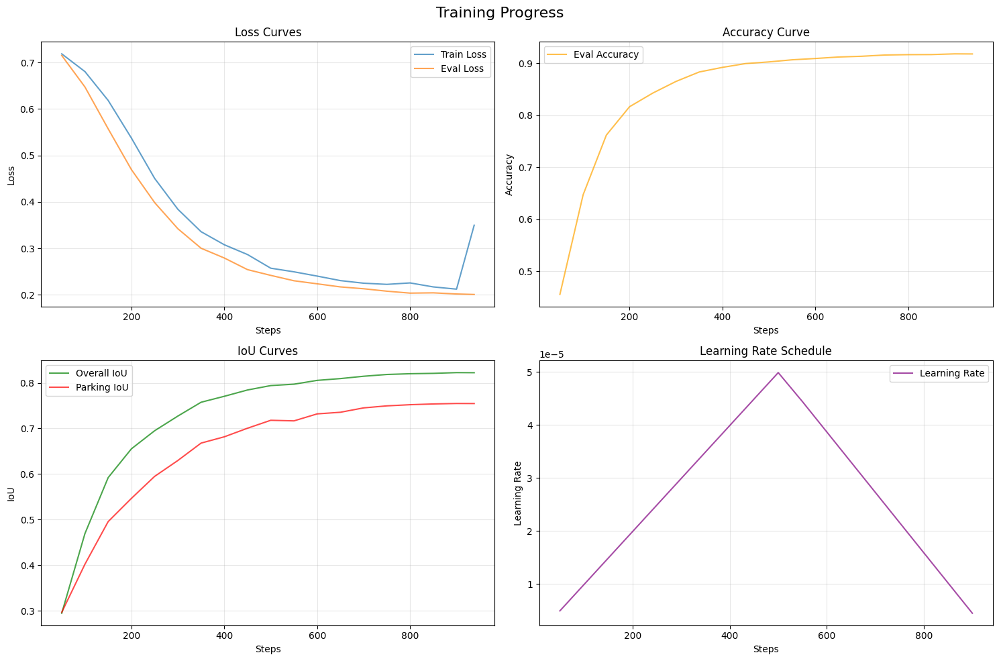

Experiment completed! Results saved to: /home/ubuntu/CS231N/outputs_enhanced/baseline_test_v1_20250604_023448
Final metrics: {'eval_loss': 0.20064935088157654, 'eval_accuracy': 0.9177864193916321, 'eval_f1': 0.9177864193916321, 'eval_iou': 0.8223240375518799, 'eval_iou_background': 0.8899507522583008, 'eval_iou_parking': 0.7546973824501038, 'eval_parking_pixel_ratio': 0.2983247786003926, 'eval_total_pixels': 51642368, 'eval_runtime': 10.2068, 'eval_samples_per_second': 19.301, 'eval_steps_per_second': 9.699, 'epoch': 2.0}
Single experiment completed!


In [33]:
# Initialize tracker
tracker = ExperimentTracker(output_path)

# Create experiment configuration
config = ExperimentConfig(
    experiment_name="baseline_test_v1",
    learning_rate=5e-5,
    logging_steps=50,
    eval_steps=50,
    per_device_train_batch_size=8,
    num_train_epochs=2,  # Start with 2 epochs for testing
    train_data_fraction=0.1,  # Use 10% of data for quick test,
    eval_data_fraction=0.1  # Use 10% of data for quick test
)

# Run experiment
result = run_experiment(
    config=config,
    train_dataset=train_ds,
    eval_dataset=eval_ds,
    tracker=tracker,
    use_wandb=False  # Set to True if you want to use wandb
)

print("Single experiment completed!")

## Option 2: Run hyperparameter search (example)

In [ ]:
# Initialize tracker
tracker = ExperimentTracker(output_path)

# Base configuration
base_config = ExperimentConfig(
    experiment_name="hp_search_v1",
    num_train_epochs=1,  # Short epochs for quick search
    logging_steps=50,
    eval_steps=50,
    train_data_fraction=0.05, # Small dataset for quick experiments
    eval_data_fraction=0.05
)

# Define hyperparameter grid
param_grid = {
    'learning_rate': [1e-5, 5e-5, 1e-4],
    'per_device_train_batch_size': [4, 8],
    'weight_decay': [0.01, 0.1]
}

# Run search
results = run_hyperparameter_search(
    base_config=base_config,
    param_grid=param_grid,
    train_dataset=train_ds,
    eval_dataset=eval_ds,
    tracker=tracker,
    max_experiments=8  # Limit for demo
)

print("Hyperparameter search completed!")

In [ ]:
graph_experiments = {
    "baseline_test_v1": "Baseline",
    "hp_search_v1_hp_001": "HP Search 1",
    "hp_search_v1_hp_002": "HP Search 1",
}

graph_results = {
    "eval_iou" : "IOU",
    "eval_iou_parking": "Parking IOU"
}

df = extract_results(graph_experiments, graph_results)    

# plot_experiment_comparison(df)

### Analyze the best model

Best experiment: epochs_5_hp_001
Best accuracy: 0.9699
Configuration: {'experiment_name': 'epochs_5_hp_001', 'model_checkpoint': 'nvidia/segformer-b0-finetuned-ade-512-512', 'learning_rate': 0.0005, 'per_device_train_batch_size': 8, 'per_device_eval_batch_size': 2, 'num_train_epochs': 4, 'warmup_steps': 2000, 'weight_decay': 0.01, 'gradient_accumulation_steps': 1, 'eval_accumulation_steps': 10, 'save_steps': 1000, 'eval_steps': 1000, 'logging_steps': 1000, 'train_data_fraction': 1.0, 'eval_data_fraction': 1.0}


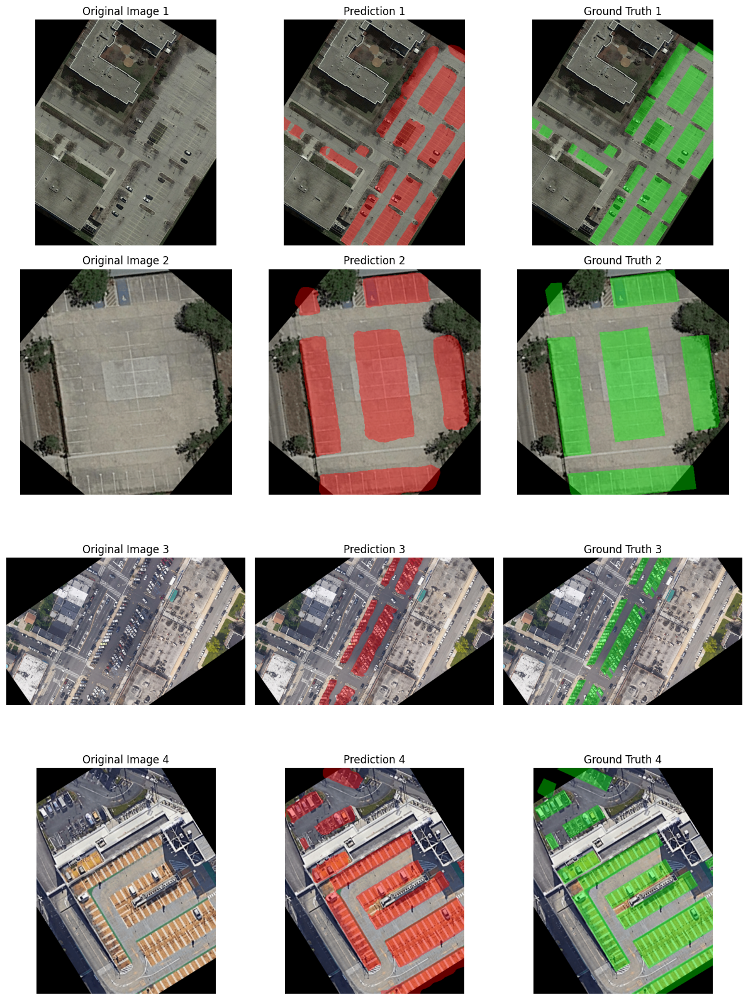

In [94]:
best_exp = tracker.get_best_experiment(metric="eval_accuracy")

if best_exp is not None:
    print(f"Best experiment: {best_exp['experiment_name']}")
    print(f"Best accuracy: {best_exp['final_metrics']['eval_accuracy']:.4f}")
    print(f"Configuration: {best_exp['config']}")
    
    # Load model for visualization
    model_path = best_exp['model_path']
    best_model = AutoModelForSemanticSegmentation.from_pretrained(model_path)
    
    # Get some test images for visualization
    test_samples = [ds[i] for i in range(5000, 5005)]  # Get 5 samples
    test_images = [sample["image"] for sample in test_samples]
    test_masks = [sample["mask"] for sample in test_samples]
    
    # Visualize predictions
    viz_predictions = visualize_predictions(best_model, processor, test_images, test_masks, num_samples=4)
    viz_predictions.show()
else:
    print("No experiments found yet. Run an experiment first!")

In [35]:
comparison_df = tracker.compare_experiments()
if not comparison_df.empty:
    print("All Experiments Summary:")
    display(comparison_df[['experiment_name', 'learning_rate', 'weight_decay', 'per_device_train_batch_size', 
                        'eval_accuracy', 'eval_iou', 'eval_f1']].round(7))
else:
    print("No experiments found. Run some experiments first!")

All Experiments Summary:


,experiment_name,learning_rate,weight_decay,per_device_train_batch_size,eval_accuracy,eval_iou,eval_f1
0,baseline_hp_001,0.00001,0.010,8,0.886441,0.765204,0.886441
1,learning_rate_hp_001,0.00005,0.010,8,0.920923,0.828501,0.920923
2,learning_rate_hp_002,0.00010,0.010,8,0.930104,0.847335,0.930104
3,learning_rate_hp_003,0.00050,0.010,8,0.939107,0.865675,0.939107
4,learning_rate_hp_004,0.00100,0.010,8,0.934009,0.855622,0.934009
5,weight_decay_hp_001,0.00050,0.000,8,0.938886,0.865581,0.938886
6,weight_decay_hp_002,0.00050,0.005,8,0.939054,0.865611,0.939054
7,weight_decay_hp_003,0.00050,0.050,8,0.939006,0.865913,0.939006
8,weight_decay_hp_004,0.00050,0.100,8,0.938509,0.864639,0.938509
9,weight_decay_hp_005,0.00050,0.500,8,0.938175,0.863937,0.938175


## Experiments on 400 APKLOT dataset (not augmented)

Loading from /home/ubuntu/CS231N/outputs_enhanced/experiment_results.json
Running 4 hyperparameter experiments...

Running Experiment: 400_apklot_hp_001


Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/segformer-b0-finetuned-ade-512-512 and are newly initialized because the shapes did not match:
- decode_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([2]) in the model instantiated
- decode_head.classifier.weight: found shape torch.Size([150, 256, 1, 1]) in the checkpoint and torch.Size([2, 256, 1, 1]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Starting training...


Step,Training Loss,Validation Loss,Accuracy,F1,Iou,Iou Background,Iou Parking,Parking Pixel Ratio,Total Pixels
20,0.687800,0.632939,0.654374,0.654374,0.481672,0.530634,0.432710,0.302435,5242880
40,0.576000,0.513900,0.805126,0.805126,0.651713,0.739454,0.563973,0.302435,5242880
60,0.500300,0.438305,0.837432,0.837432,0.692494,0.785012,0.599977,0.302435,5242880
80,0.435100,0.376858,0.861444,0.861444,0.727838,0.816330,0.639347,0.302435,5242880
100,0.400100,0.359483,0.862882,0.862882,0.732923,0.816108,0.649738,0.302435,5242880
120,0.369400,0.335602,0.871837,0.871837,0.744964,0.829211,0.660716,0.302435,5242880
140,0.369200,0.326621,0.878540,0.878540,0.755581,0.838024,0.673138,0.302435,5242880
160,0.347600,0.318335,0.876353,0.876353,0.753408,0.834261,0.672556,0.302435,5242880
180,0.348800,0.313862,0.878887,0.878887,0.757325,0.837695,0.676954,0.302435,5242880


Running final evaluation...


Experiment '400_apklot_hp_001' saved!


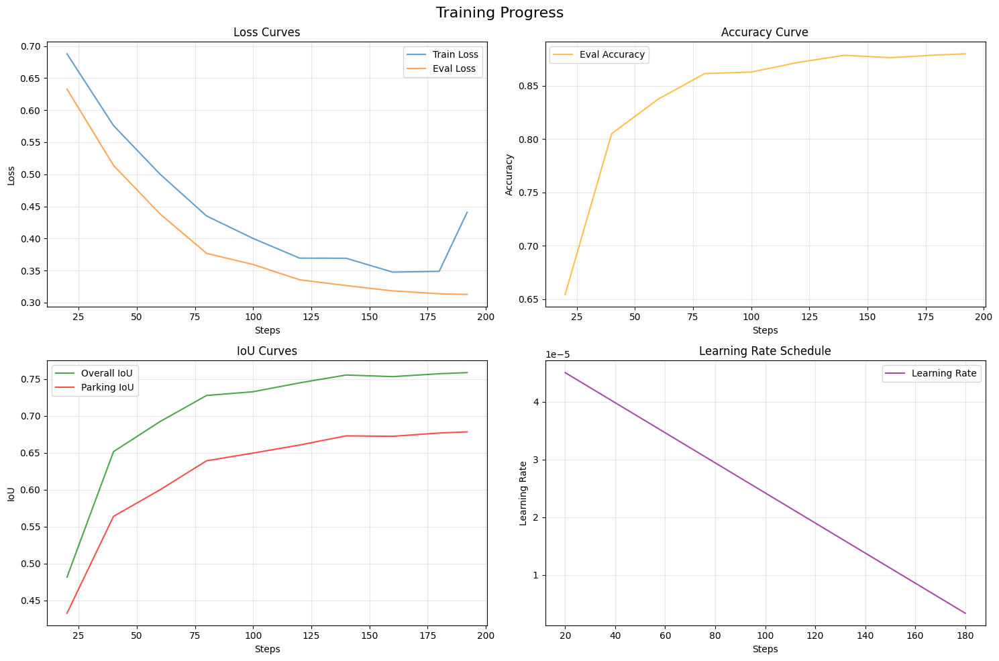

Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/segformer-b0-finetuned-ade-512-512 and are newly initialized because the shapes did not match:
- decode_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([2]) in the model instantiated
- decode_head.classifier.weight: found shape torch.Size([150, 256, 1, 1]) in the checkpoint and torch.Size([2, 256, 1, 1]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Experiment completed! Results saved to: /home/ubuntu/CS231N/outputs_enhanced/400_apklot_hp_001_20250605_001432
Final metrics: {'eval_loss': 0.31276461482048035, 'eval_accuracy': 0.8799047470092773, 'eval_f1': 0.8799047470092773, 'eval_iou': 0.758833646774292, 'eval_iou_background': 0.8391211628913879, 'eval_iou_parking': 0.6785460710525513, 'eval_parking_pixel_ratio': 0.30243473052978515, 'eval_total_pixels': 5242880, 'eval_runtime': 1.8498, 'eval_samples_per_second': 10.812, 'eval_steps_per_second': 5.406, 'epoch': 4.0}

Running Experiment: 400_apklot_hp_002
Starting training...


Step,Training Loss,Validation Loss,Accuracy,F1,Iou,Iou Background,Iou Parking,Parking Pixel Ratio,Total Pixels
20,0.643500,0.530198,0.787353,0.787353,0.630937,0.713226,0.548648,0.302435,5242880
40,0.471900,0.416715,0.852153,0.852153,0.718737,0.800305,0.637170,0.302435,5242880
60,0.387000,0.314677,0.878031,0.878031,0.752536,0.838763,0.666310,0.302435,5242880
80,0.327900,0.282719,0.892049,0.892049,0.776397,0.856557,0.696238,0.302435,5242880
100,0.299600,0.272121,0.890295,0.890295,0.777469,0.851776,0.703162,0.302435,5242880
120,0.271900,0.256375,0.896514,0.896514,0.788146,0.859883,0.716408,0.302435,5242880
140,0.273700,0.246048,0.905190,0.905190,0.800833,0.872750,0.728916,0.302435,5242880
160,0.257600,0.242104,0.902601,0.902601,0.798041,0.868312,0.727770,0.302435,5242880
180,0.257900,0.237926,0.904516,0.904516,0.801401,0.870835,0.731968,0.302435,5242880


Running final evaluation...


Experiment '400_apklot_hp_002' saved!


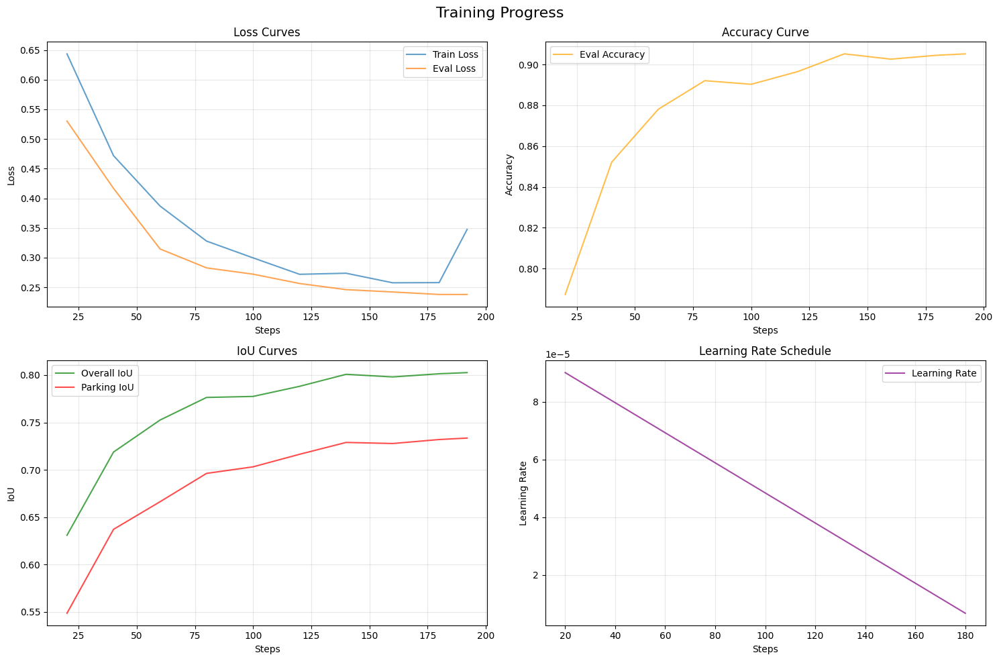

Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/segformer-b0-finetuned-ade-512-512 and are newly initialized because the shapes did not match:
- decode_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([2]) in the model instantiated
- decode_head.classifier.weight: found shape torch.Size([150, 256, 1, 1]) in the checkpoint and torch.Size([2, 256, 1, 1]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Experiment completed! Results saved to: /home/ubuntu/CS231N/outputs_enhanced/400_apklot_hp_002_20250605_001555
Final metrics: {'eval_loss': 0.2379179447889328, 'eval_accuracy': 0.9051797986030579, 'eval_f1': 0.9051797986030579, 'eval_iou': 0.8026052713394165, 'eval_iou_background': 0.8716903328895569, 'eval_iou_parking': 0.7335201501846313, 'eval_parking_pixel_ratio': 0.30243473052978515, 'eval_total_pixels': 5242880, 'eval_runtime': 1.8552, 'eval_samples_per_second': 10.78, 'eval_steps_per_second': 5.39, 'epoch': 4.0}

Running Experiment: 400_apklot_hp_003
Starting training...


Step,Training Loss,Validation Loss,Accuracy,F1,Iou,Iou Background,Iou Parking,Parking Pixel Ratio,Total Pixels
20,0.490300,0.309993,0.865555,0.865555,0.730435,0.824095,0.636776,0.302435,5242880
40,0.331700,0.268582,0.882971,0.882971,0.760949,0.844947,0.676950,0.302435,5242880
60,0.275700,0.241452,0.898392,0.898392,0.788556,0.864073,0.713039,0.302435,5242880
80,0.242900,0.215019,0.906404,0.906404,0.805132,0.873086,0.737178,0.302435,5242880
100,0.228600,0.195802,0.915465,0.915465,0.822023,0.884718,0.759329,0.302435,5242880
120,0.206800,0.197581,0.915777,0.915777,0.822556,0.885155,0.759957,0.302435,5242880
140,0.207600,0.193086,0.917136,0.917136,0.823957,0.887585,0.760330,0.302435,5242880
160,0.192700,0.186378,0.920642,0.920642,0.830612,0.892128,0.769097,0.302435,5242880
180,0.184900,0.180180,0.924935,0.924935,0.838179,0.898081,0.778276,0.302435,5242880


Running final evaluation...


Experiment '400_apklot_hp_003' saved!


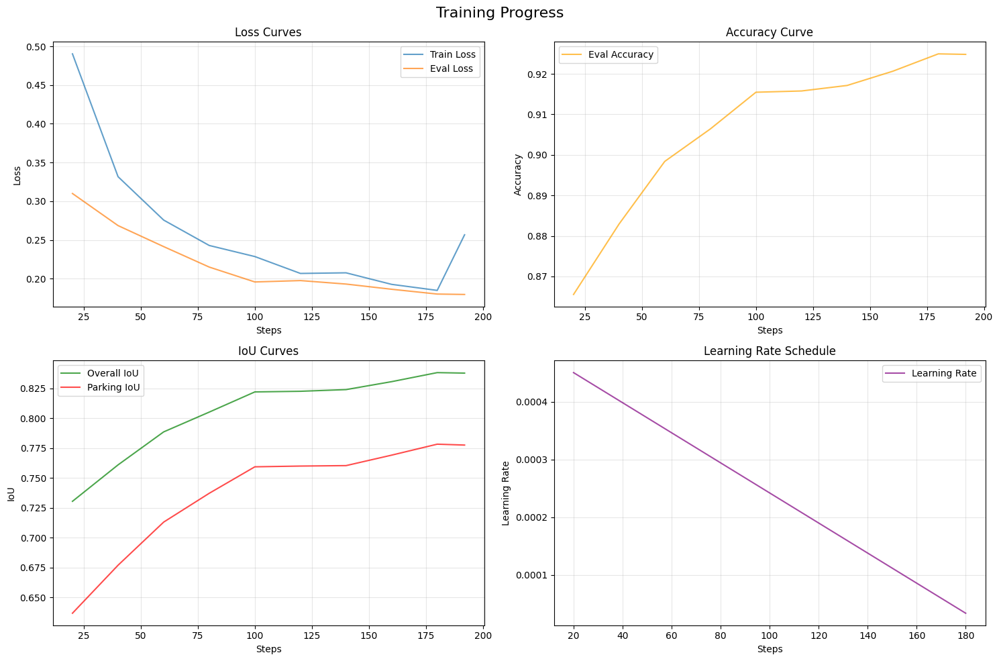

Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/segformer-b0-finetuned-ade-512-512 and are newly initialized because the shapes did not match:
- decode_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([2]) in the model instantiated
- decode_head.classifier.weight: found shape torch.Size([150, 256, 1, 1]) in the checkpoint and torch.Size([2, 256, 1, 1]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Experiment completed! Results saved to: /home/ubuntu/CS231N/outputs_enhanced/400_apklot_hp_003_20250605_001724
Final metrics: {'eval_loss': 0.17965467274188995, 'eval_accuracy': 0.9248079061508179, 'eval_f1': 0.9248079061508179, 'eval_iou': 0.8377686142921448, 'eval_iou_background': 0.8980029225349426, 'eval_iou_parking': 0.7775343060493469, 'eval_parking_pixel_ratio': 0.30243473052978515, 'eval_total_pixels': 5242880, 'eval_runtime': 1.8711, 'eval_samples_per_second': 10.689, 'eval_steps_per_second': 5.344, 'epoch': 4.0}

Running Experiment: 400_apklot_hp_004
Starting training...


Step,Training Loss,Validation Loss,Accuracy,F1,Iou,Iou Background,Iou Parking,Parking Pixel Ratio,Total Pixels
20,0.469700,0.331235,0.855650,0.855650,0.706666,0.816401,0.596932,0.302435,5242880
40,0.355200,0.287871,0.877698,0.877698,0.751497,0.838633,0.664360,0.302435,5242880
60,0.298200,0.241791,0.898193,0.898193,0.790233,0.862602,0.717865,0.302435,5242880
80,0.257100,0.248528,0.894116,0.894116,0.784671,0.856315,0.713026,0.302435,5242880
100,0.242500,0.205400,0.912491,0.912491,0.813589,0.882503,0.744674,0.302435,5242880
120,0.230900,0.216294,0.906935,0.906935,0.805380,0.874202,0.736558,0.302435,5242880
140,0.217500,0.205858,0.913649,0.913649,0.812039,0.885851,0.738227,0.302435,5242880
160,0.202500,0.186367,0.919832,0.919832,0.827414,0.891973,0.762855,0.302435,5242880
180,0.188900,0.191252,0.918726,0.918726,0.825678,0.890348,0.761008,0.302435,5242880


Running final evaluation...


Experiment '400_apklot_hp_004' saved!


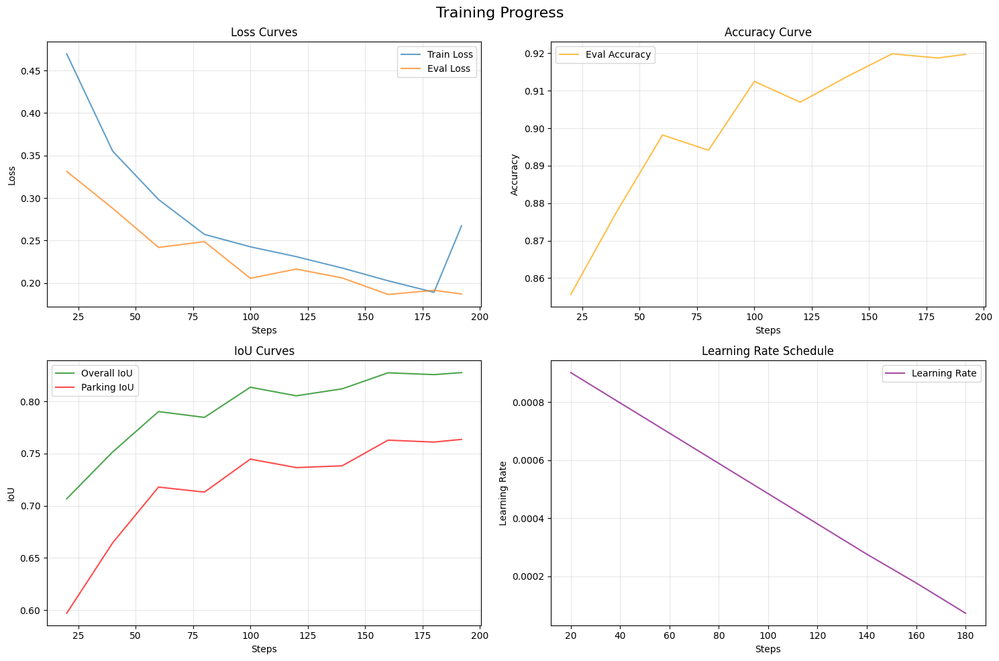

Experiment completed! Results saved to: /home/ubuntu/CS231N/outputs_enhanced/400_apklot_hp_004_20250605_001848
Final metrics: {'eval_loss': 0.18691271543502808, 'eval_accuracy': 0.9197157025337219, 'eval_f1': 0.9197157025337219, 'eval_iou': 0.8275930881500244, 'eval_iou_background': 0.8916114568710327, 'eval_iou_parking': 0.7635746598243713, 'eval_parking_pixel_ratio': 0.30243473052978515, 'eval_total_pixels': 5242880, 'eval_runtime': 1.856, 'eval_samples_per_second': 10.776, 'eval_steps_per_second': 5.388, 'epoch': 4.0}
Hyperparameter search completed!


In [133]:
# Initialize tracker
tracker = ExperimentTracker(output_path)

# Base configuration
base_config = ExperimentConfig(
    experiment_name="400_apklot", # dont forget to change me 
    logging_steps=20,
    eval_steps=20,
)

# Define hyperparameter grid
param_grid = {
    'learning_rate': [5e-5, 1e-4, 5e-4, 1e-3],
    'per_device_train_batch_size': [8],
    'weight_decay': [0.01],
    'warmup_steps': [0],
    'num_train_epochs': [4], # weve also tried 2
    'train_data_fraction': [1.0],
    'eval_data_fraction': [1.0],
}

# Run search
results = run_hyperparameter_search(
    base_config=base_config,
    param_grid=param_grid,
    train_dataset=train_ds,
    eval_dataset=eval_ds,
    tracker=tracker,
)

print("Hyperparameter search completed!")

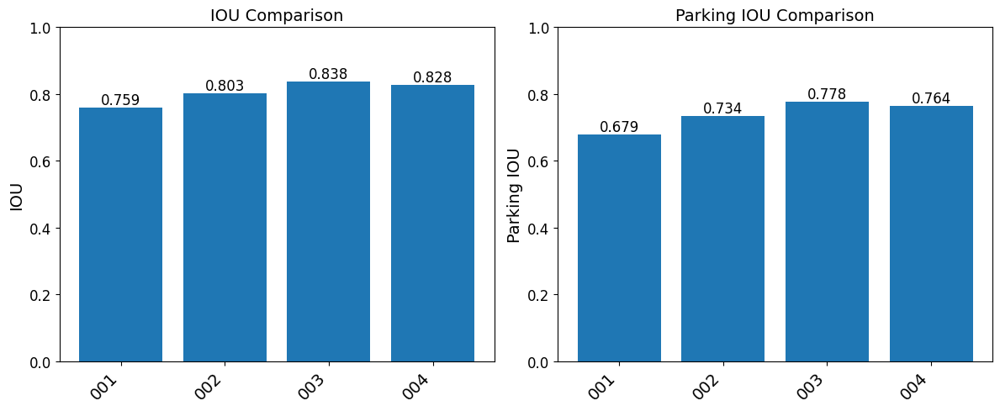

In [134]:
graph_experiments = {
    "400_apklot_hp_001": "001",
    "400_apklot_hp_002": "002",
    "400_apklot_hp_003": "003",
    "400_apklot_hp_004": "004",
    # "400_apklot_hp_005": "005",
    # "400_apklot_hp_006": "006",
    # "400_apklot_hp_007": "007",
    # "400_apklot_hp_008": "008",
    # "400_apklot_hp_009": "009",
    # "400_apklot_hp_010": "010",
    # "400_apklot_hp_011": "011",
    # "400_apklot_hp_012": "012",
    # "400_apklot_hp_013": "013",
    # "400_apklot_hp_014": "014",
    # "400_apklot_hp_015": "015",
    # "400_apklot_hp_016": "016",
    # "400_apklot_hp_017": "017",
    # "400_apklot_hp_018": "018",
    # "400_apklot_hp_019": "019",
    # "400_apklot_hp_020": "020",
    # "400_apklot_hp_021": "021",
    # "400_apklot_hp_022": "022",
    # "400_apklot_hp_023": "023",
    # "400_apklot_hp_024": "024",
}

graph_results = {
    "eval_iou" : "IOU",
    "eval_iou_parking": "Parking IOU"
}

df = extract_results(graph_experiments, graph_results)    

plt = plot_experiment_comparison(df)
plt.savefig("400_apklot.png", dpi=300, bbox_inches='tight')

### Get Results on Test Set

In [144]:
model_path = 'outputs_enhanced/400_apklot_hp_003_20250605_001724'
best_model = AutoModelForSemanticSegmentation.from_pretrained(model_path)

image_folder = "/home/ubuntu/CS231N/APKLOT_original/testing/images"
mask_folder = "/home/ubuntu/CS231N/APKLOT_original/testing/masks"

preprocessed_data = load_and_preprocess_images(image_folder, processor, best_model.device, 0, 400)

# Run predictions and evaluate IoUs
results = make_predictions_and_evaluate_iou(
    data=preprocessed_data,
    model=best_model,
    processor=processor,
    image_folder=image_folder,
    mask_folder=mask_folder,
    num_samples=400
)

Starting
Processed 10 images...
Processed 20 images...
Processed 30 images...
Processed 40 images...
Processed 50 images...
Processed 60 images...
Processed 70 images...
Processed 80 images...
Processed 90 images...
Processed 100 images...
=== Overall IoU ===
background_iou: 0.8844
parking_block_iou: 0.6859
miou: 0.7851


98.png Parking IoU: 0.8991 mIoU: 0.9025
6.png Parking IoU: 0.8946 mIoU: 0.9281
64.png Parking IoU: 0.8945 mIoU: 0.9151
63.png Parking IoU: 0.8822 mIoU: 0.8995
20.png Parking IoU: 0.8809 mIoU: 0.9119
65.png Parking IoU: 0.8766 mIoU: 0.8872
19.png Parking IoU: 0.8726 mIoU: 0.8593
2.png Parking IoU: 0.8708 mIoU: 0.8702
18.png Parking IoU: 0.8651 mIoU: 0.9109
27.png Parking IoU: 0.8585 mIoU: 0.8671


<module 'matplotlib.pyplot' from '/home/ubuntu/CS231N/ll-env/lib/python3.10/site-packages/matplotlib/pyplot.py'>

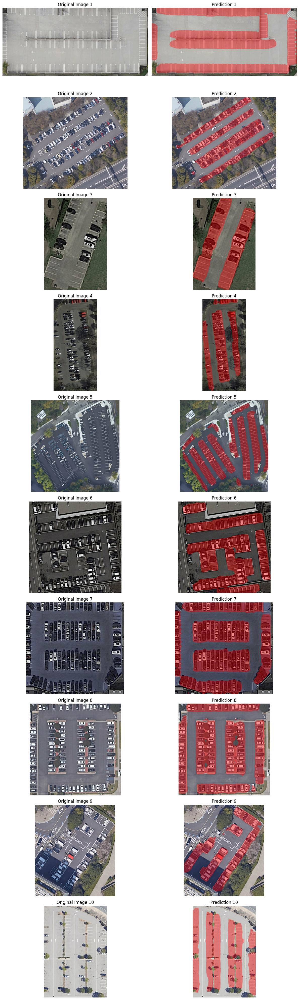

In [145]:
# Sort by Parking Block IoU
sorted_results = dict(sorted(
    results["per_image"].items(),
    key=lambda x: x[1]["class_1_iou"],  # Sort by parking block IoU
    reverse=True
))

# Visualize top 10 predictions with highest parking block IoU
top_10 = []
for img_name in list(sorted_results.keys())[:10]:
    print(img_name,
          f"Parking IoU: {sorted_results[img_name]['class_1_iou']:.4f}",
          f"mIoU: {sorted_results[img_name]['miou']:.4f}")
    
    img_path = os.path.join(image_folder, img_name)
    try:
        img = Image.open(img_path).convert("RGB")
        top_10.append(img)
    except Exception as e:
        print(f"⚠️ Could not open {img_name}: {e}")

# Visualize (if compatible with your visualize_predictions function)
visualize_predictions(best_model, processor, top_10, num_samples=10)

# Experiments

## Baseline

Loading from /home/ubuntu/CS231N/outputs_enhanced/experiment_results.json
Running 1 hyperparameter experiments...

Running Experiment: baseline_hp_001


Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/segformer-b0-finetuned-ade-512-512 and are newly initialized because the shapes did not match:
- decode_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([2]) in the model instantiated
- decode_head.classifier.weight: found shape torch.Size([150, 256, 1, 1]) in the checkpoint and torch.Size([2, 256, 1, 1]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Using 9365 training samples (25.0%)
Using 493 evaluation samples (25.0%)
Starting training...


Step,Training Loss,Validation Loss,Accuracy,F1,Iou,Iou Background,Iou Parking,Parking Pixel Ratio,Total Pixels
250,0.497600,0.459236,0.811893,0.811893,0.656553,0.752488,0.560617,0.300082,129236992
500,0.385900,0.355082,0.863874,0.863874,0.727037,0.822422,0.631653,0.300082,129236992
750,0.338300,0.317940,0.877394,0.877394,0.750209,0.838716,0.661702,0.300082,129236992
1000,0.326200,0.300727,0.883443,0.883443,0.759958,0.846586,0.673330,0.300082,129236992


Running final evaluation...


Experiment 'baseline_hp_001' saved!


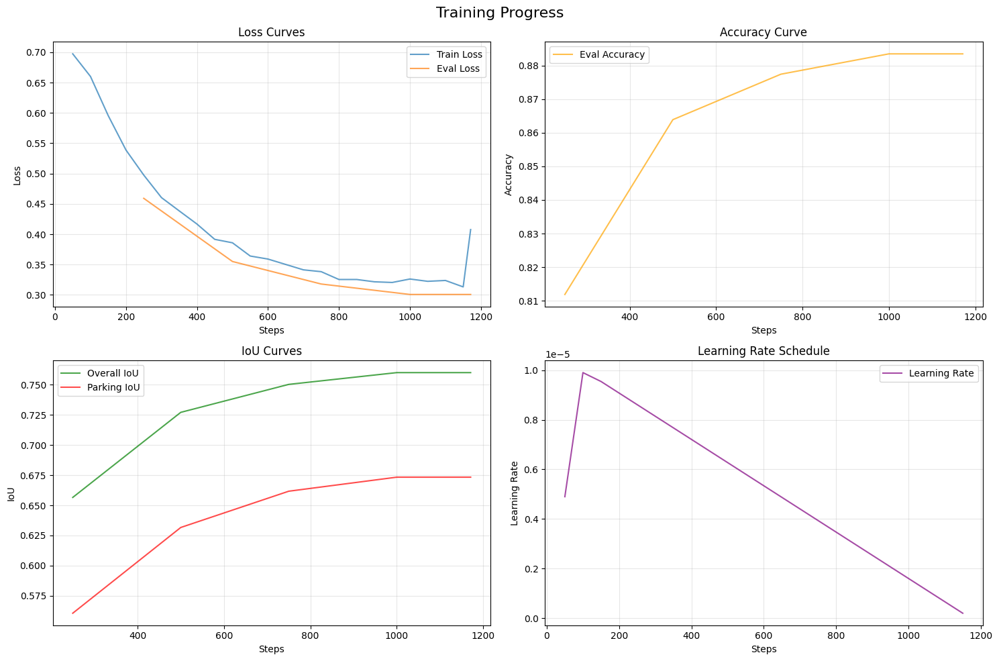

Experiment completed! Results saved to: /home/ubuntu/CS231N/outputs_enhanced/baseline_hp_001_20250604_024501
Final metrics: {'eval_loss': 0.3007271885871887, 'eval_accuracy': 0.883443295955658, 'eval_f1': 0.883443295955658, 'eval_iou': 0.7599582076072693, 'eval_iou_background': 0.8465861678123474, 'eval_iou_parking': 0.6733302474021912, 'eval_parking_pixel_ratio': 0.3000823866281258, 'eval_total_pixels': 129236992, 'eval_runtime': 23.1736, 'eval_samples_per_second': 21.274, 'eval_steps_per_second': 10.659, 'epoch': 1.0}
Hyperparameter search completed!


In [36]:
# Initialize tracker
tracker = ExperimentTracker(output_path)

# Base configuration
base_config = ExperimentConfig(
    experiment_name="baseline",
    logging_steps=250,
    eval_steps=250,
)

# Define hyperparameter grid
param_grid = {
    'learning_rate': [1e-5],
    'per_device_train_batch_size': [8],
    'weight_decay': [0.01],
    'warmup_steps': [100],
    'num_train_epochs': [1],
    'train_data_fraction': [0.25],
    'eval_data_fraction': [0.25],
}

# Run search
results = run_hyperparameter_search(
    base_config=base_config,
    param_grid=param_grid,
    train_dataset=train_ds,
    eval_dataset=eval_ds,
    tracker=tracker,
)

print("Hyperparameter search completed!")

## Explore learning rate

In [ ]:
# Initialize tracker
tracker = ExperimentTracker(output_path)

# Base configuration
base_config = ExperimentConfig(
    experiment_name="learning_rate", # dont forget to change me 
    logging_steps=250,
    eval_steps=250,
)

# Define hyperparameter grid
param_grid = {
    'learning_rate': [5e-5, 1e-4, 5e-4, 1e-3],
    'per_device_train_batch_size': [8],
    'weight_decay': [0.01],
    'warmup_steps': [100],
    'num_train_epochs': [1], # weve also tried 2
    'train_data_fraction': [0.25],
    'eval_data_fraction': [0.25],
}

# Run search
results = run_hyperparameter_search(
    base_config=base_config,
    param_grid=param_grid,
    train_dataset=train_ds,
    eval_dataset=eval_ds,
    tracker=tracker,
)

print("Hyperparameter search completed!")

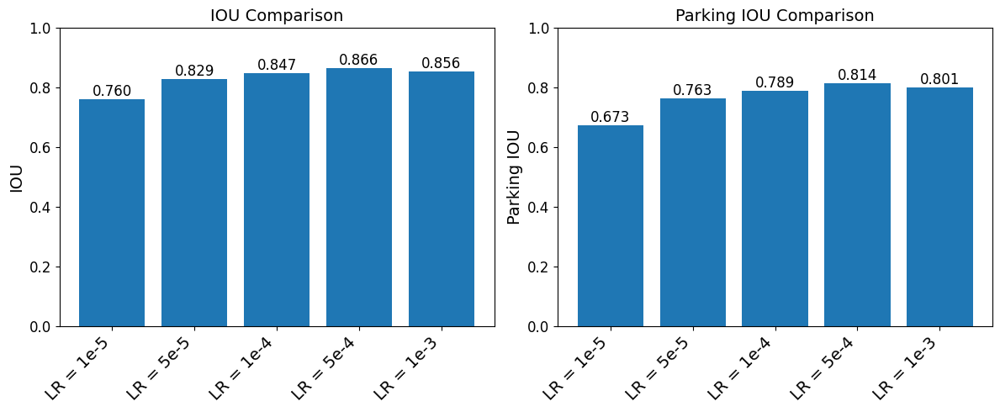

In [29]:
graph_experiments = {
    "baseline_hp_001": "LR = 1e-5",
    "learning_rate_hp_001": "LR = 5e-5",
    "learning_rate_hp_002": "LR = 1e-4",
    "learning_rate_hp_003": "LR = 5e-4",
    "learning_rate_hp_004": "LR = 1e-3",
}

graph_results = {
    "eval_iou" : "IOU",
    "eval_iou_parking": "Parking IOU"
}

df = extract_results(graph_experiments, graph_results)    

plt = plot_experiment_comparison(df)
plt.savefig("learning_rates.png", dpi=300, bbox_inches='tight')

## Weight Decay 

In [ ]:
# Initialize tracker
tracker = ExperimentTracker(output_path)

# Base configuration
base_config = ExperimentConfig(
    experiment_name="weight_decay", # dont forget to change me 
    logging_steps=250,
    eval_steps=250,
)

# Define hyperparameter grid
param_grid = {
    'learning_rate': [5e-4],
    'per_device_train_batch_size': [8],
    'weight_decay': [0, 0.005, 0.01, 0.05, 0.1, 0.5], # already did 0.01 above
    'warmup_steps': [100],
    'num_train_epochs': [1], # 
    'train_data_fraction': [0.25],
    'eval_data_fraction': [0.25],
}

# Run search
results = run_hyperparameter_search(
    base_config=base_config,
    param_grid=param_grid,
    train_dataset=train_ds,
    eval_dataset=eval_ds,
    tracker=tracker,
)

print("Hyperparameter search completed!")

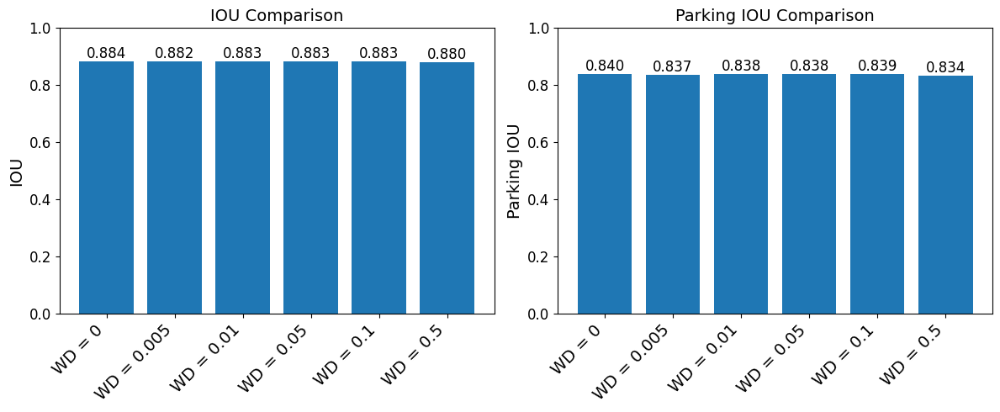

In [30]:
graph_experiments = {
    "weight_decay_hp_001": "WD = 0",
    "weight_decay_hp_002": "WD = 0.005",
    "weight_decay_hp_003": "WD = 0.01",
    "weight_decay_hp_004": "WD = 0.05",
    "weight_decay_hp_005": "WD = 0.1",
    "weight_decay_hp_006": "WD = 0.5",
}

graph_results = {
    "eval_iou" : "IOU",
    "eval_iou_parking": "Parking IOU",
    # "eval_f1": "F1"
}

df = extract_results(graph_experiments, graph_results)    

plt = plot_experiment_comparison(df)
plt.savefig("weight_decay.png", dpi=300, bbox_inches='tight')

## Explore warmup steps 

In [ ]:
# Initialize tracker
tracker = ExperimentTracker(output_path)

# Base configuration
base_config = ExperimentConfig(
    experiment_name="warmup", # dont forget to change me 
    logging_steps=250,
    eval_steps=250,
)

# Define hyperparameter grid
param_grid = {
    'learning_rate': [5e-4],
    'per_device_train_batch_size': [8],
    'weight_decay': [0.01],
    'warmup_steps': [0, 250, 500], # 100 done above
    'num_train_epochs': [1],
    'train_data_fraction': [0.25],
    'eval_data_fraction': [0.25],
}

# Run search
results = run_hyperparameter_search(
    base_config=base_config,
    param_grid=param_grid,
    train_dataset=train_ds,
    eval_dataset=eval_ds,
    tracker=tracker,
)

print("Hyperparameter search completed!")

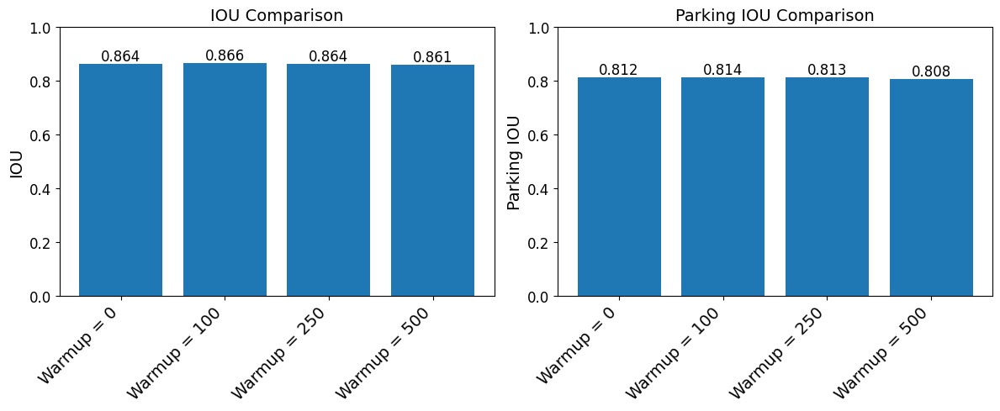

In [31]:
graph_experiments = {
    "warmup_hp_001": "Warmup = 0",
    "learning_rate_hp_003": "Warmup = 100",
    "warmup_hp_002": "Warmup = 250",
    "warmup_hp_003": "Warmup = 500",
}

graph_results = {
    "eval_iou" : "IOU",
    "eval_iou_parking": "Parking IOU",
    # "eval_f1": "F1"
}

df = extract_results(graph_experiments, graph_results)    

plt = plot_experiment_comparison(df)
plt.savefig("warmup_steps.png", dpi=300, bbox_inches='tight')

## Grid Search: LR and Warmup

In [ ]:
# Initialize tracker
#tracker = ExperimentTracker(output_path)

# Base configuration
#base_config = ExperimentConfig(
#    experiment_name="grid_search_0.5", # dont forget to change me 
#    logging_steps=250,
#    eval_steps=250,
#)

# Define hyperparameter grid
#param_grid = {
#    'learning_rate': [5e-5, 1e-4, 5e-4],
#    'per_device_train_batch_size': [8],
#    'weight_decay': [0.05], 
#    'warmup_steps': [0, 100],
#    'num_train_epochs': [2],
#    'train_data_fraction': [0.5],
#    'eval_data_fraction': [0.5],
#}

# Run search
#results = run_hyperparameter_search(
#    base_config=base_config,
#    param_grid=param_grid,
#    train_dataset=train_ds,
#    eval_dataset=eval_ds,
#    tracker=tracker,
#)

#print("Hyperparameter search completed!")

In [ ]:
#graph_experiments = {
#    "grid_search_0.5_hp_001": "LR = 5e-5, Warmup=0",
#    "grid_search_0.5_hp_002": "LR = 1e-4, Warmup=0",
#    "grid_search_0.5_hp_003": "LR = 5e-4, Warmup=0",
#    "grid_search_0.5_hp_004": "LR = 5e-5, Warmup=100",
#    "grid_search_0.5_hp_005": "LR = 1e-4, Warmup=100",
#    "grid_search_0.5_hp_006": "LR = 5e-4, Warmup=100"
#}

#graph_results = {
#    "eval_iou" : "IOU",
#    "eval_iou_parking": "Parking IOU",
#    # "eval_f1": "F1"
#}

#df = extract_results(graph_experiments, graph_results)    

# plot_experiment_comparison(df)

## Scale data

### 0.5

In [ ]:
# Initialize tracker
tracker = ExperimentTracker(output_path)

# Base configuration
base_config = ExperimentConfig(
    experiment_name="scale_0.50", # dont forget to change me 
    logging_steps=250*2, # scale me as dataset scales 
    eval_steps=250*2,  # scale me as dataset scales 
)

# Define hyperparameter grid
param_grid = {
    'learning_rate': [5e-4],
    'per_device_train_batch_size': [8],
    'weight_decay': [0.01], 
    'warmup_steps': [100 * 2], # scale me as dataset scales 
    'num_train_epochs': [1],
    'train_data_fraction': [0.5],
    'eval_data_fraction': [0.5],
}

# Run search
results = run_hyperparameter_search(
    base_config=base_config,
    param_grid=param_grid,
    train_dataset=train_ds,
    eval_dataset=eval_ds,
    tracker=tracker,
)

print("Hyperparameter search completed!")

### 0.75

In [ ]:
# Initialize tracker
tracker = ExperimentTracker(output_path)

# Base configuration
base_config = ExperimentConfig(
    experiment_name="scale_0.75", # dont forget to change me 
    logging_steps=250*4, # scale me as dataset scales 
    eval_steps=250*4,  # scale me as dataset scales 
)

# Define hyperparameter grid
param_grid = {
    'learning_rate': [5e-4],
    'per_device_train_batch_size': [8],
    'weight_decay': [0.01], 
    'warmup_steps': [100 * 3], # scale me as dataset scales 
    'num_train_epochs': [1],
    'train_data_fraction': [0.75],
    'eval_data_fraction': [0.75],
}

# Run search
results = run_hyperparameter_search(
    base_config=base_config,
    param_grid=param_grid,
    train_dataset=train_ds,
    eval_dataset=eval_ds,
    tracker=tracker,
)

print("Hyperparameter search completed!")

### 1.0

In [ ]:
# Initialize tracker
tracker = ExperimentTracker(output_path)

# Base configuration
base_config = ExperimentConfig(
    experiment_name="scale_1.0", # dont forget to change me 
    logging_steps=250*4, # scale me as dataset scales 
    eval_steps=250*4,  # scale me as dataset scales 
)

# Define hyperparameter grid
param_grid = {
    'learning_rate': [5e-4],
    'per_device_train_batch_size': [8],
    'weight_decay': [0.01], 
    'warmup_steps': [100 * 4], # scale me as dataset scales 
    'num_train_epochs': [1],
    'train_data_fraction': [1.0],
    'eval_data_fraction': [1.0],
}

# Run search
results = run_hyperparameter_search(
    base_config=base_config,
    param_grid=param_grid,
    train_dataset=train_ds,
    eval_dataset=eval_ds,
    tracker=tracker,
)

print("Hyperparameter search completed!")

### Results

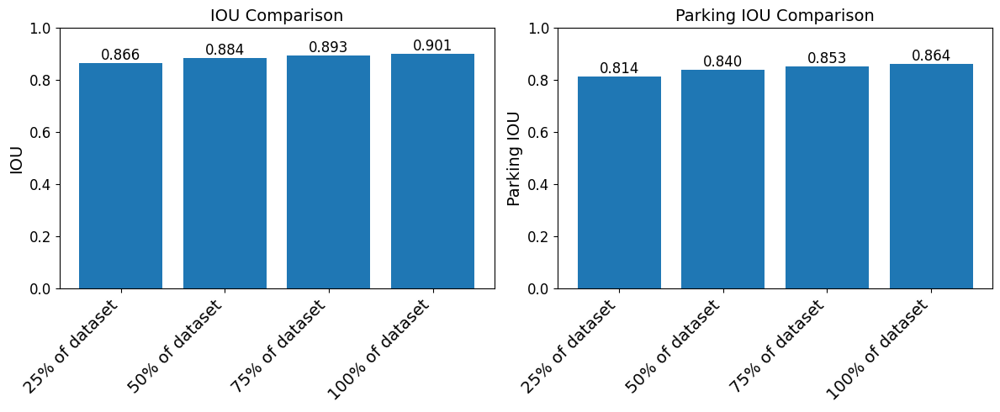

In [32]:
graph_experiments = {
    "learning_rate_hp_003": "25% of dataset",
    "scale_0.50_hp_001": "50% of dataset",
    "scale_0.75_hp_001": "75% of dataset",
    "scale_1.0_hp_001": "100% of dataset",
}

graph_results = {
    "eval_iou" : "IOU",
    "eval_iou_parking": "Parking IOU",
    # "eval_f1": "F1"
}

df = extract_results(graph_experiments, graph_results)    

plt = plot_experiment_comparison(df)
plt.savefig("scale_dataset.png", dpi=300, bbox_inches='tight')

## Test epcohs 

### 2 epochs 

Running 1 hyperparameter experiments...

Running Experiment: epochs_2_hp_001


Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/segformer-b0-finetuned-ade-512-512 and are newly initialized because the shapes did not match:
- decode_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([2]) in the model instantiated
- decode_head.classifier.weight: found shape torch.Size([150, 256, 1, 1]) in the checkpoint and torch.Size([2, 256, 1, 1]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Starting training...


Step,Training Loss,Validation Loss,Accuracy,F1,Iou,Iou Background,Iou Parking,Parking Pixel Ratio,Total Pixels
1000,0.184400,0.177436,0.925083,0.925083,0.838927,0.898022,0.779833,0.301340,516947968
2000,0.153300,0.141386,0.939485,0.939485,0.867431,0.916882,0.817980,0.301340,516947968
3000,0.126900,0.120913,0.947296,0.947296,0.883324,0.927260,0.839388,0.301340,516947968
4000,0.120800,0.111652,0.950628,0.950628,0.890672,0.931476,0.849869,0.301340,516947968
5000,0.108600,0.099860,0.955354,0.955354,0.899930,0.938146,0.861714,0.301340,516947968
6000,0.099900,0.091478,0.958491,0.958491,0.906829,0.942243,0.871416,0.301340,516947968
7000,0.093500,0.086022,0.960373,0.960373,0.910708,0.944855,0.876560,0.301340,516947968
8000,0.086700,0.079637,0.962914,0.962914,0.916100,0.948330,0.883869,0.301340,516947968
9000,0.081300,0.075983,0.964389,0.964389,0.919295,0.950327,0.888263,0.301340,516947968


Running final evaluation...


Experiment 'epochs_2_hp_001' saved!


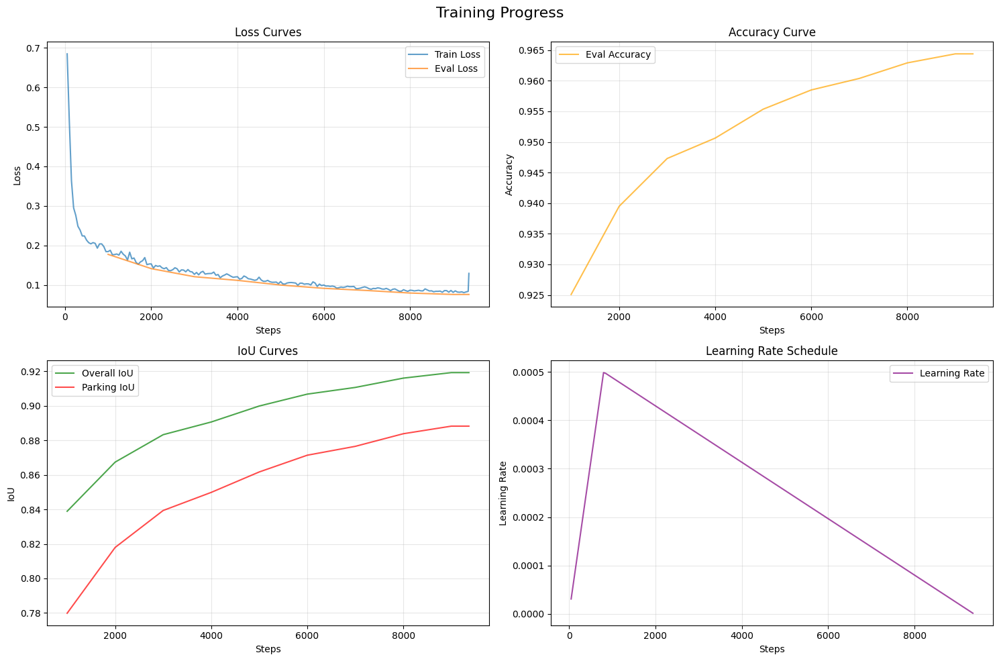

Experiment completed! Results saved to: /home/ubuntu/CS231N/outputs_enhanced/epochs_2_hp_001_20250602_222112
Final metrics: {'eval_loss': 0.07598332315683365, 'eval_accuracy': 0.9643892049789429, 'eval_f1': 0.9643891453742981, 'eval_iou': 0.9192953109741211, 'eval_iou_background': 0.9503272175788879, 'eval_iou_parking': 0.8882633447647095, 'eval_parking_pixel_ratio': 0.30133990003419453, 'eval_total_pixels': 516947968, 'eval_runtime': 98.9894, 'eval_samples_per_second': 19.921, 'eval_steps_per_second': 9.961, 'epoch': 2.0}
Hyperparameter search completed!


In [28]:
# Initialize tracker
tracker = ExperimentTracker(output_path)

# Base configuration
base_config = ExperimentConfig(
    experiment_name="epochs_2", # dont forget to change me 
    logging_steps=250*4, # scale me as dataset scales 
    eval_steps=250*4,  # scale me as dataset scales 
)

# Define hyperparameter grid
param_grid = {
    'learning_rate': [5e-4],
    'per_device_train_batch_size': [8],
    'weight_decay': [0.01], 
    'warmup_steps': [100 * 4 * 2], # scale me as dataset and epochs scales 
    'num_train_epochs': [2],
    'train_data_fraction': [1.0],
    'eval_data_fraction': [1.0],
}

# Run search
results = run_hyperparameter_search(
    base_config=base_config,
    param_grid=param_grid,
    train_dataset=train_ds,
    eval_dataset=eval_ds,
    tracker=tracker,
)

print("Hyperparameter search completed!")

### 3 epochs 

Running 1 hyperparameter experiments...

Running Experiment: epochs_3_hp_001


Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/segformer-b0-finetuned-ade-512-512 and are newly initialized because the shapes did not match:
- decode_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([2]) in the model instantiated
- decode_head.classifier.weight: found shape torch.Size([150, 256, 1, 1]) in the checkpoint and torch.Size([2, 256, 1, 1]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Starting training...


Step,Training Loss,Validation Loss,Accuracy,F1,Iou,Iou Background,Iou Parking,Parking Pixel Ratio,Total Pixels
1000,0.196700,0.182434,0.923337,0.923337,0.833669,0.896750,0.770587,0.301340,516947968
2000,0.158700,0.147773,0.936664,0.936664,0.861731,0.913179,0.810282,0.301340,516947968
3000,0.131100,0.133724,0.941205,0.941205,0.871708,0.918726,0.824690,0.301340,516947968
4000,0.125800,0.116987,0.948801,0.948801,0.886488,0.929240,0.843737,0.301340,516947968
5000,0.119700,0.107415,0.952489,0.952489,0.893980,0.934267,0.853692,0.301340,516947968
6000,0.111000,0.097852,0.956045,0.956045,0.901450,0.939044,0.863856,0.301340,516947968
7000,0.101800,0.093542,0.957683,0.957683,0.905124,0.941148,0.869100,0.301340,516947968
8000,0.095800,0.088424,0.959338,0.959338,0.908788,0.943309,0.874267,0.301340,516947968
9000,0.088300,0.083030,0.961631,0.961631,0.913415,0.946552,0.880278,0.301340,516947968
10000,0.082200,0.076826,0.963953,0.963953,0.918429,0.949696,0.887162,0.301340,516947968


Running final evaluation...


Experiment 'epochs_3_hp_001' saved!


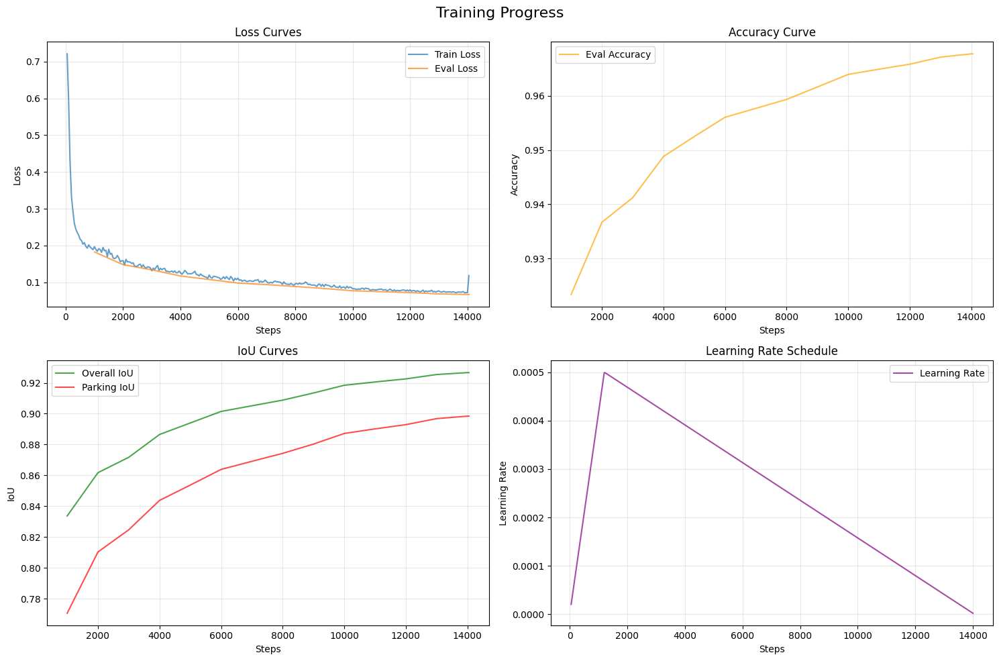

Experiment completed! Results saved to: /home/ubuntu/CS231N/outputs_enhanced/epochs_3_hp_001_20250602_232600
Final metrics: {'eval_loss': 0.06675822287797928, 'eval_accuracy': 0.9677435755729675, 'eval_f1': 0.9677435755729675, 'eval_iou': 0.9266355633735657, 'eval_iou_background': 0.9548718929290771, 'eval_iou_parking': 0.8983992338180542, 'eval_parking_pixel_ratio': 0.30133990003419453, 'eval_total_pixels': 516947968, 'eval_runtime': 100.0599, 'eval_samples_per_second': 19.708, 'eval_steps_per_second': 9.854, 'epoch': 3.0}
Hyperparameter search completed!


In [29]:
# Initialize tracker
tracker = ExperimentTracker(output_path)

# Base configuration
base_config = ExperimentConfig(
    experiment_name="epochs_3", # dont forget to change me 
    logging_steps=250*4, # scale me as dataset scales 
    eval_steps=250*4,  # scale me as dataset scales 
)

# Define hyperparameter grid
param_grid = {
    'learning_rate': [5e-4],
    'per_device_train_batch_size': [8],
    'weight_decay': [0.01], 
    'warmup_steps': [100 * 4 * 3], # scale me as dataset and epochs scales 
    'num_train_epochs': [3],
    'train_data_fraction': [1.0],
    'eval_data_fraction': [1.0],
}

# Run search
results = run_hyperparameter_search(
    base_config=base_config,
    param_grid=param_grid,
    train_dataset=train_ds,
    eval_dataset=eval_ds,
    tracker=tracker,
)

print("Hyperparameter search completed!")

### 4 Epochs

Running 1 hyperparameter experiments...

Running Experiment: epochs_4_hp_001


Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/segformer-b0-finetuned-ade-512-512 and are newly initialized because the shapes did not match:
- decode_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([2]) in the model instantiated
- decode_head.classifier.weight: found shape torch.Size([150, 256, 1, 1]) in the checkpoint and torch.Size([2, 256, 1, 1]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Starting training...


Step,Training Loss,Validation Loss,Accuracy,F1,Iou,Iou Background,Iou Parking,Parking Pixel Ratio,Total Pixels
1000,0.186500,0.177802,0.926671,0.926671,0.840059,0.901108,0.779011,0.301340,516947968
2000,0.163400,0.156056,0.934303,0.934303,0.856078,0.910565,0.801590,0.301340,516947968
3000,0.133600,0.131403,0.942811,0.942811,0.874435,0.921143,0.827726,0.301340,516947968
4000,0.128700,0.117311,0.948333,0.948333,0.885803,0.928469,0.843137,0.301340,516947968
5000,0.121900,0.111772,0.950549,0.950549,0.890258,0.931502,0.849014,0.301340,516947968
6000,0.112600,0.104798,0.953402,0.953402,0.896094,0.935387,0.856800,0.301340,516947968
7000,0.103700,0.097738,0.956081,0.956081,0.901439,0.939136,0.863742,0.301340,516947968
8000,0.099600,0.089779,0.959123,0.959123,0.908120,0.943126,0.873114,0.301340,516947968
9000,0.091000,0.087278,0.960224,0.960224,0.910246,0.944725,0.875766,0.301340,516947968
10000,0.085600,0.080498,0.962590,0.962590,0.915603,0.947788,0.883417,0.301340,516947968


Running final evaluation...


Experiment 'epochs_4_hp_001' saved!


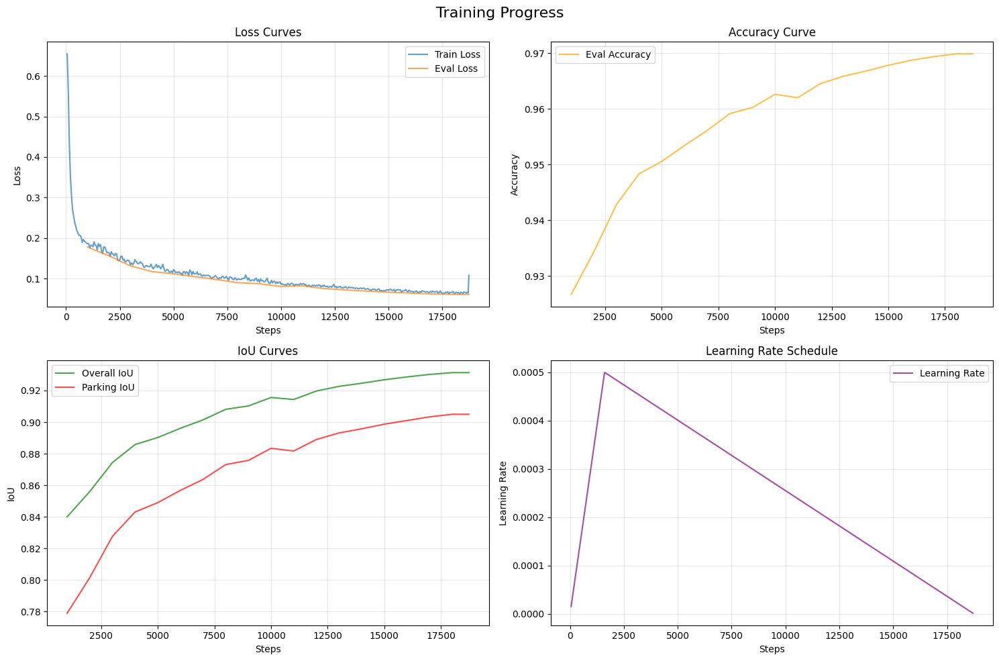

Experiment completed! Results saved to: /home/ubuntu/CS231N/outputs_enhanced/epochs_4_hp_001_20250603_013250
Final metrics: {'eval_loss': 0.060875583440065384, 'eval_accuracy': 0.9698546528816223, 'eval_f1': 0.9698545932769775, 'eval_iou': 0.9313431978225708, 'eval_iou_background': 0.9577158689498901, 'eval_iou_parking': 0.9049705862998962, 'eval_parking_pixel_ratio': 0.30133990003419453, 'eval_total_pixels': 516947968, 'eval_runtime': 100.8212, 'eval_samples_per_second': 19.559, 'eval_steps_per_second': 9.78, 'epoch': 4.0}
Hyperparameter search completed!


In [35]:
# Initialize tracker
tracker = ExperimentTracker(output_path)

# Base configuration
base_config = ExperimentConfig(
    experiment_name="epochs_4", # dont forget to change me 
    logging_steps=250*4, # scale me as dataset scales 
    eval_steps=250*4,  # scale me as dataset scales 
)

# Define hyperparameter grid
param_grid = {
    'learning_rate': [5e-4],
    'per_device_train_batch_size': [8],
    'weight_decay': [0.01], 
    'warmup_steps': [100 * 4 * 4], # scale me as dataset and epochs scales 
    'num_train_epochs': [4],
    'train_data_fraction': [1.0],
    'eval_data_fraction': [1.0],
}

# Run search
results = run_hyperparameter_search(
    base_config=base_config,
    param_grid=param_grid,
    train_dataset=train_ds,
    eval_dataset=eval_ds,
    tracker=tracker,
)

print("Hyperparameter search completed!")

### 5 epochs

Running 1 hyperparameter experiments...

Running Experiment: epochs_5_hp_001


Some weights of SegformerForSemanticSegmentation were not initialized from the model checkpoint at nvidia/segformer-b0-finetuned-ade-512-512 and are newly initialized because the shapes did not match:
- decode_head.classifier.bias: found shape torch.Size([150]) in the checkpoint and torch.Size([2]) in the model instantiated
- decode_head.classifier.weight: found shape torch.Size([150, 256, 1, 1]) in the checkpoint and torch.Size([2, 256, 1, 1]) in the model instantiated
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.


Starting training...


Step,Training Loss,Validation Loss,Accuracy,F1,Iou,Iou Background,Iou Parking,Parking Pixel Ratio,Total Pixels
1000,0.187800,0.175389,0.926697,0.926697,0.840603,0.900893,0.780312,0.301340,516947968
2000,0.171300,0.157674,0.932407,0.932407,0.854006,0.907181,0.800830,0.301340,516947968
3000,0.137800,0.136265,0.940517,0.940517,0.869703,0.918146,0.821260,0.301340,516947968
4000,0.131500,0.125743,0.944889,0.944889,0.879290,0.923574,0.835005,0.301340,516947968
5000,0.127000,0.115313,0.949389,0.949389,0.887953,0.929897,0.846009,0.301340,516947968
6000,0.116100,0.104749,0.953266,0.953266,0.895550,0.935336,0.855764,0.301340,516947968
7000,0.105900,0.100017,0.955161,0.955161,0.899781,0.937757,0.861804,0.301340,516947968
8000,0.101900,0.091909,0.958315,0.958315,0.906412,0.942027,0.870797,0.301340,516947968
9000,0.093000,0.093792,0.957669,0.957669,0.904647,0.941352,0.867942,0.301340,516947968
10000,0.089500,0.084102,0.961247,0.961247,0.912627,0.946015,0.879238,0.301340,516947968


Running final evaluation...


Experiment 'epochs_5_hp_001' saved!


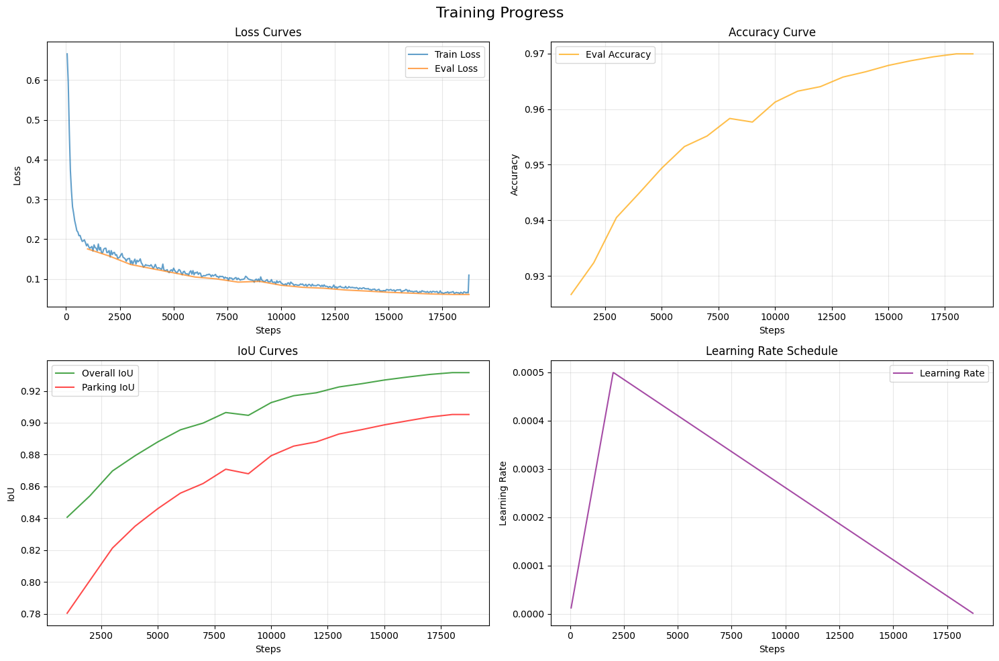

Experiment completed! Results saved to: /home/ubuntu/CS231N/outputs_enhanced/epochs_5_hp_001_20250603_055631
Final metrics: {'eval_loss': 0.06088702380657196, 'eval_accuracy': 0.9699200391769409, 'eval_f1': 0.9699200391769409, 'eval_iou': 0.9314898252487183, 'eval_iou_background': 0.9578040838241577, 'eval_iou_parking': 0.9051757454872131, 'eval_parking_pixel_ratio': 0.30133990003419453, 'eval_total_pixels': 516947968, 'eval_runtime': 97.2557, 'eval_samples_per_second': 20.276, 'eval_steps_per_second': 10.138, 'epoch': 4.0}
Hyperparameter search completed!


In [98]:
# Initialize tracker
tracker = ExperimentTracker(output_path)

# Base configuration
base_config = ExperimentConfig(
    experiment_name="epochs_5", # dont forget to change me 
    logging_steps=250*4, # scale me as dataset scales 
    eval_steps=250*4,  # scale me as dataset scales 
)

# Define hyperparameter grid
param_grid = {
    'learning_rate': [5e-4],
    'per_device_train_batch_size': [8],
    'weight_decay': [0.01], 
    'warmup_steps': [100 * 4 * 5], # scale me as dataset and epochs scales 
    'num_train_epochs': [4],
    'train_data_fraction': [1.0],
    'eval_data_fraction': [1.0],
}

# Run search
results = run_hyperparameter_search(
    base_config=base_config,
    param_grid=param_grid,
    train_dataset=train_ds,
    eval_dataset=eval_ds,
    tracker=tracker,
)

print("Hyperparameter search completed!")

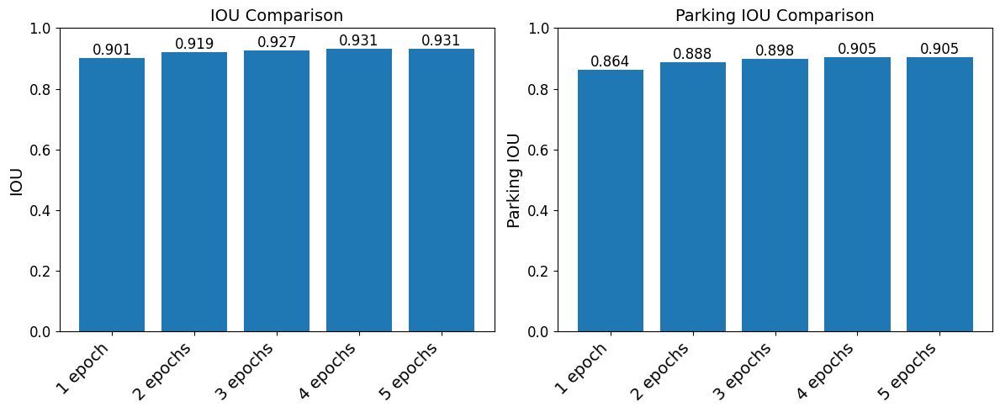

In [33]:
graph_experiments = {
    "scale_1.0_hp_001": "1 epoch",
    "epochs_2_hp_001": "2 epochs",
    "epochs_3_hp_001": "3 epochs",
    "epochs_4_hp_001": "4 epochs",
    "epochs_5_hp_001": "5 epochs",
}

graph_results = {
    "eval_iou" : "IOU",
    "eval_iou_parking": "Parking IOU",
    # "eval_f1": "F1"
}

df = extract_results(graph_experiments, graph_results)    

plt = plot_experiment_comparison(df)
plt.savefig("epochs.png", dpi=300, bbox_inches='tight')

# See how model does on images

## APKLOT

Best experiment: epochs_5_hp_001
Best accuracy: 0.9699
Configuration: {'experiment_name': 'epochs_5_hp_001', 'model_checkpoint': 'nvidia/segformer-b0-finetuned-ade-512-512', 'learning_rate': 0.0005, 'per_device_train_batch_size': 8, 'per_device_eval_batch_size': 2, 'num_train_epochs': 4, 'warmup_steps': 2000, 'weight_decay': 0.01, 'gradient_accumulation_steps': 1, 'eval_accumulation_steps': 10, 'save_steps': 1000, 'eval_steps': 1000, 'logging_steps': 1000, 'train_data_fraction': 1.0, 'eval_data_fraction': 1.0}


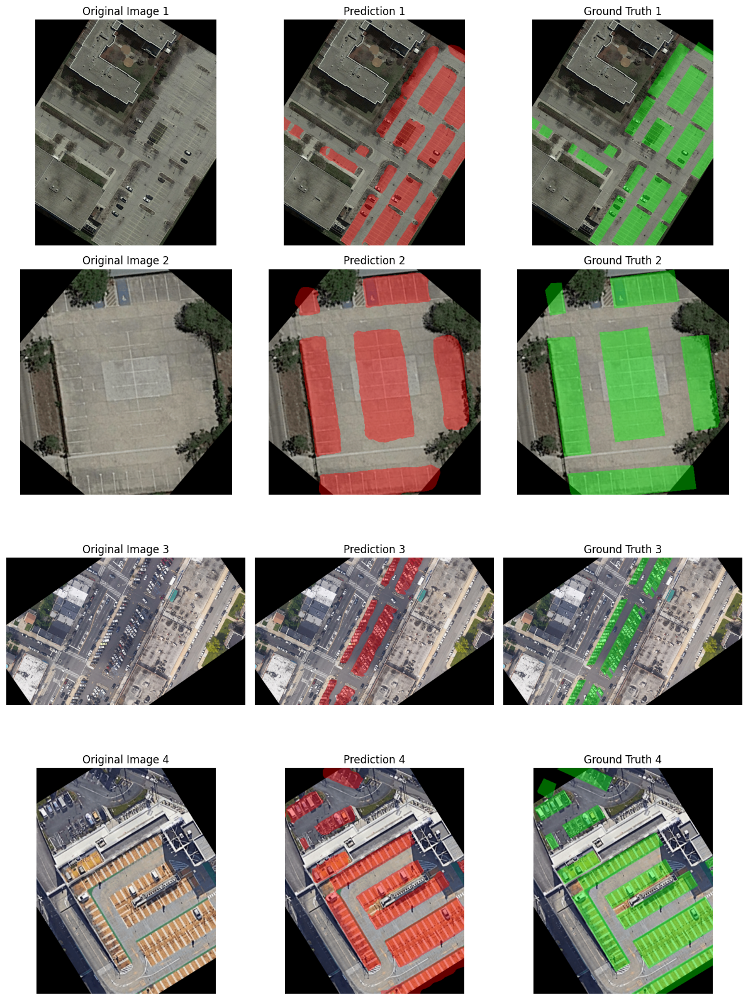

In [37]:
best_exp = tracker.get_best_experiment(metric="eval_accuracy")

if best_exp is not None:
    print(f"Best experiment: {best_exp['experiment_name']}")
    print(f"Best accuracy: {best_exp['final_metrics']['eval_accuracy']:.4f}")
    print(f"Configuration: {best_exp['config']}")
    
    # Load model for visualization
    model_path = best_exp['model_path']
    best_model = AutoModelForSemanticSegmentation.from_pretrained(model_path)
    
    # Get some test images for visualization
    test_samples = [ds[i] for i in range(5000, 5005)]  # Get 5 samples
    test_images = [sample["image"] for sample in test_samples]
    test_masks = [sample["mask"] for sample in test_samples]
    
    # Visualize predictions
    viz_predictions = visualize_predictions(best_model, processor, test_images, test_masks, num_samples=4)
    viz_predictions.show()
else:
    print("No experiments found yet. Run an experiment first!")

## Test images

In [142]:
def load_and_preprocess_images(image_folder: str, processor, device: str, start_index, end_index) -> List[Tuple[str, Image.Image, torch.Tensor]]:
    """Load and preprocess images from a folder"""
    image_files = [f for f in os.listdir(image_folder) if f.lower().endswith('.png')]
    image_files = image_files[start_index:min(end_index, len(image_files))]
    
    preprocessed = []
    print('Starting')
    for i, image_file in enumerate(image_files):
        try:
            img_path = os.path.join(image_folder, image_file)
            img = Image.open(img_path).convert("RGB")

            dummy_mask = Image.new("L", img.size, color=0)
            processed = processor(img, dummy_mask, return_tensors="pt")
            device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
            pixel_values = processed["pixel_values"].to(device)

            preprocessed.append((image_file, img, pixel_values))

        except Exception as e:
            print(f"Error preprocessing {image_file}: {e}")
            continue

        if (i + 1) % 500 == 0:
            print(f"Processed {i + 1} images...")

        # Free memory after each batch
        torch.cuda.empty_cache()
        torch.cuda.ipc_collect()
        gc.collect()

    return preprocessed

In [139]:
def make_predictions(data, model, processor, target_class: int = 1, num_samples: Optional[int] = None) -> Dict[str, Dict]:
    """Predict and record number of target class pixels for each image file in a folder"""
    model.eval()
    prediction_counts = {}
    solar_irradance_dict = {}

    with open('solar_irradiance_results.json', 'r') as f:
        solar_irradance_dict = json.load(f)

    print('Starting')
    for idx, (image_file, img, pixel_values) in enumerate(data[:num_samples]):
        try:
            img_path = os.path.join(image_folder, image_file)
            img = Image.open(img_path).convert("RGB")

            # Create dummy mask
            dummy_mask = Image.new("L", img.size, color=0)
            processed = processor(img, dummy_mask, return_tensors="pt")
            pixel_values = processed["pixel_values"].to(model.device)

            # Model prediction
            with torch.no_grad():
                outputs = model(pixel_values=pixel_values)
                logits = outputs.logits
                logits = torch.nn.functional.interpolate(
                    logits, size=img.size[::-1], 
                    mode="bilinear", align_corners=False
                )
                pred_mask = torch.argmax(logits, dim=1).squeeze(0).cpu().numpy()

            # Count target class pixels
            predicted_pixels = int(np.sum(pred_mask == target_class))
            # print("predicted_pixels: ", predicted_pixels);
            total_pixels = int(pred_mask.size)
            # print("total_pixels: ", total_pixels);
            predicted_area = predicted_pixels * 0.6 * 0.6
            # print("predicted_area: ", predicted_area);
            solar_irradance = predicted_area * solar_irradance_dict[image_file]["annual_dni_kWh/m2/day"] * 0.2
            proportion = predicted_pixels / total_pixels

            # Save results
            prediction_counts[image_file] = {
                "predicted_pixels": predicted_pixels,
                "predicted_area": predicted_area,
                "predicted_solar_irradiance": solar_irradance,
                "total_pixels": total_pixels,
                "proportion": proportion
            }

            if (idx + 1) % 500 == 0:
                print(f"Processed {idx + 1} images...")

        except Exception as e:
            print(f"Error processing {image_file}: {e}")
            continue
    
    return prediction_counts



def make_predictions_and_evaluate_iou(
    data, model, processor, image_folder: str, mask_folder: str,
    target_class: int = 1, num_samples: Optional[int] = None
) -> Dict[str, Dict]:

    model.eval()
    prediction_stats = {}
    
    intersection = {0: 0, 1: 0}
    union = {0: 0, 1: 0}

    for idx, (image_file, img, _) in enumerate(data[:num_samples]):
        try:
            img_path = os.path.join(image_folder, image_file)
            mask_path = os.path.join(mask_folder, image_file)  # Assumes same filename
            
            img = Image.open(img_path).convert("RGB")
            gt_mask = Image.open(mask_path).convert("L")
            gt_mask = np.array(gt_mask)
            gt_mask = (gt_mask > 0).astype(np.uint8)  # Binary: 0 or 1

            # Preprocess
            dummy_mask = Image.new("L", img.size, color=0)
            processed = processor(img, dummy_mask, return_tensors="pt")
            pixel_values = processed["pixel_values"].to(model.device)

            with torch.no_grad():
                outputs = model(pixel_values=pixel_values)
                logits = outputs.logits
                logits = torch.nn.functional.interpolate(
                    logits, size=img.size[::-1], 
                    mode="bilinear", align_corners=False
                )
                pred_mask = torch.argmax(logits, dim=1).squeeze(0).cpu().numpy()

            image_iou = {}

            for cls in [0, 1]:
                pred_inds = (pred_mask == cls)
                gt_inds = (gt_mask == cls)

                inter = np.logical_and(pred_inds, gt_inds).sum()
                uni = np.logical_or(pred_inds, gt_inds).sum()

                intersection[cls] += inter
                union[cls] += uni

                image_iou[f'class_{cls}_iou'] = inter / uni if uni > 0 else 0

            image_iou["miou"] = (image_iou['class_0_iou'] + image_iou['class_1_iou']) / 2
            prediction_stats[image_file] = image_iou

            if (idx + 1) % 10 == 0:
                print(f"Processed {idx + 1} images...")

        except Exception as e:
            print(f"Error processing {image_file}: {e}")
            continue

    overall_iou = {
        'background_iou': intersection[0] / union[0] if union[0] > 0 else 0,
        'parking_block_iou': intersection[1] / union[1] if union[1] > 0 else 0,
    }
    overall_iou['miou'] = (overall_iou['background_iou'] + overall_iou['parking_block_iou']) / 2

    print("=== Overall IoU ===")
    for k, v in overall_iou.items():
        print(f"{k}: {v:.4f}")

    return {
        "per_image": prediction_stats,
        "overall": overall_iou
    }

### Visualize best predictions from model

In [36]:
output_dir = "outputs_enhanced"

# Load the tracker
tracker = ExperimentTracker(output_dir)

# Get the best experiment by accuracy
best_exp = tracker.get_best_experiment(metric="eval_accuracy")
print("Best experiment:", best_exp["experiment_name"])
print("Accuracy:", best_exp["final_metrics"]["eval_accuracy"])
print("Model path:", best_exp["model_path"])
model_path = best_exp['model_path']
best_model = AutoModelForSemanticSegmentation.from_pretrained(model_path)

Loading from outputs_enhanced/experiment_results.json
Best experiment: epochs_5_hp_001
Accuracy: 0.9699200391769409
Model path: /home/ubuntu/CS231N/outputs_enhanced/epochs_5_hp_001_20250603_055631


## Process and Predict on GEE Test Images

In [22]:
image_folder = "/home/ubuntu/CS231N/inference_images"
torch.cuda.empty_cache()
torch.cuda.ipc_collect()
preprocessed_data = load_and_preprocess_images(image_folder, processor, best_model.device, 12000, 16941)

Starting
Processed 500 images...
Processed 1000 images...
Processed 1500 images...
Processed 2000 images...
Processed 2500 images...
Processed 3000 images...
Processed 3500 images...
Processed 4000 images...
Processed 4500 images...


Starting
Processed 500 images...
Processed 1000 images...
Processed 1500 images...
Processed 2000 images...
Processed 2500 images...
Processed 3000 images...
Processed 3500 images...
Processed 4000 images...
Processed 4500 images...
lot16750.png 79045.56 m^2 90586.21176
lot16035.png 46967.03999999999 m^2 73268.5824
lot14505.png 55118.52 m^2 59858.71272
lot13035.png 54522.0 m^2 59210.89199999999
lot14446.png 55827.35999999999 m^2 55715.705279999995
lot12042.png 33078.24 m^2 51734.367360000004
lot12410.png 34377.119999999995 m^2 51703.18847999999
lot14449.png 41119.2 m^2 41036.9616
lot12130.png 24730.92 m^2 38580.235199999996
lot12044.png 23911.2 m^2 37397.1168


<module 'matplotlib.pyplot' from '/home/ubuntu/CS231N/ll-env/lib/python3.10/site-packages/matplotlib/pyplot.py'>

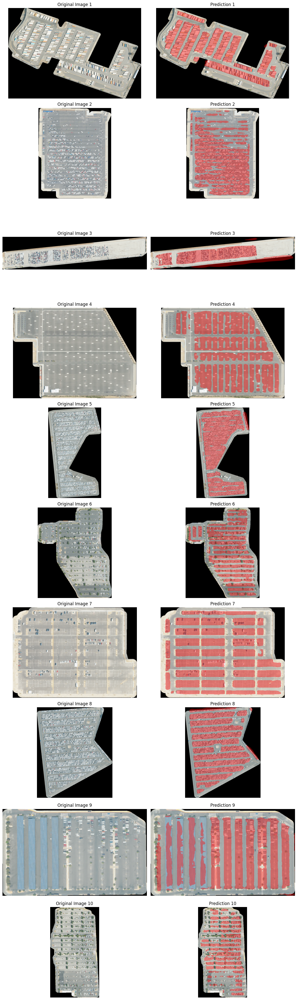

In [25]:
predictions = make_predictions(preprocessed_data, best_model, processor)

sorted_results = dict(sorted(predictions.items(), key=lambda x: x[1]["predicted_solar_irradiance"], reverse=True))

top_10 = []
image_folder = "/home/ubuntu/CS231N/inference_images"
# image_folder = "/home/ubuntu/CS231N/APKLOT_original/testing/images"

for img_name in list(sorted_results.keys())[:10]:
    print(img_name, sorted_results[img_name]['predicted_area'], "m^2", sorted_results[img_name]['predicted_solar_irradiance'])
    img_path = os.path.join(image_folder, img_name)
    try:
        img = Image.open(img_path).convert("RGB")
        top_10.append(img)
    except Exception as e:
        print(f"Could not open {img_name}: {e}")

visualize_predictions(best_model, processor, top_10, num_samples=10)

### Run Predictions on APKLOT test images

Processed 10 images...
Processed 20 images...
Processed 30 images...
Processed 40 images...
Processed 50 images...
Processed 60 images...
Processed 70 images...
Processed 80 images...
Processed 90 images...
Processed 100 images...
=== Overall IoU ===
background_iou: 0.8844
parking_block_iou: 0.6859
miou: 0.7851
98.png Parking IoU: 0.8991 mIoU: 0.9025
6.png Parking IoU: 0.8946 mIoU: 0.9281
64.png Parking IoU: 0.8945 mIoU: 0.9151
63.png Parking IoU: 0.8822 mIoU: 0.8995
20.png Parking IoU: 0.8809 mIoU: 0.9119
65.png Parking IoU: 0.8766 mIoU: 0.8872
19.png Parking IoU: 0.8726 mIoU: 0.8593
2.png Parking IoU: 0.8708 mIoU: 0.8702
18.png Parking IoU: 0.8651 mIoU: 0.9109
27.png Parking IoU: 0.8585 mIoU: 0.8671


<module 'matplotlib.pyplot' from '/home/ubuntu/CS231N/ll-env/lib/python3.10/site-packages/matplotlib/pyplot.py'>

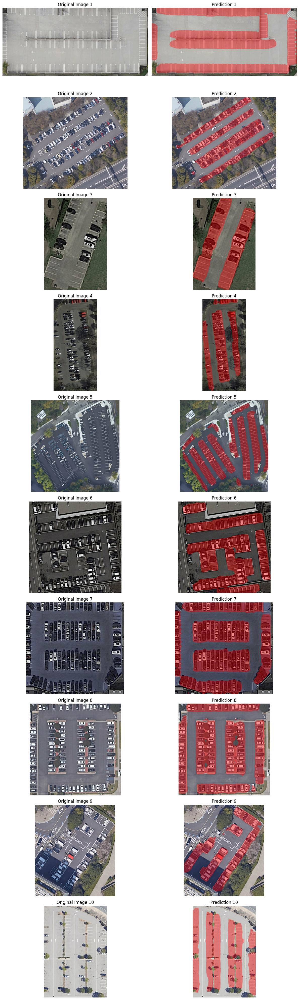

In [147]:
image_folder = "/home/ubuntu/CS231N/APKLOT_original/testing/images"
mask_folder = "/home/ubuntu/CS231N/APKLOT_original/testing/masks"

# Run predictions and evaluate IoUs
results = make_predictions_and_evaluate_iou(
    data=preprocessed_data,
    model=best_model,
    processor=processor,
    image_folder=image_folder,
    mask_folder=mask_folder,
    num_samples=100
)

# Sort by Parking Block IoU
sorted_results = dict(sorted(
    results["per_image"].items(),
    key=lambda x: x[1]["class_1_iou"],  # Sort by parking block IoU
    reverse=True
))

# Visualize top 10 predictions with highest parking block IoU
top_10 = []
for img_name in list(sorted_results.keys())[:10]:
    print(img_name,
          f"Parking IoU: {sorted_results[img_name]['class_1_iou']:.4f}",
          f"mIoU: {sorted_results[img_name]['miou']:.4f}")
    
    img_path = os.path.join(image_folder, img_name)
    try:
        img = Image.open(img_path).convert("RGB")
        top_10.append(img)
    except Exception as e:
        print(f"⚠️ Could not open {img_name}: {e}")

# Visualize (if compatible with your visualize_predictions function)
visualize_predictions(best_model, processor, top_10, num_samples=10)

## Visualize good and poor predictions

Saved: good_predictions.png


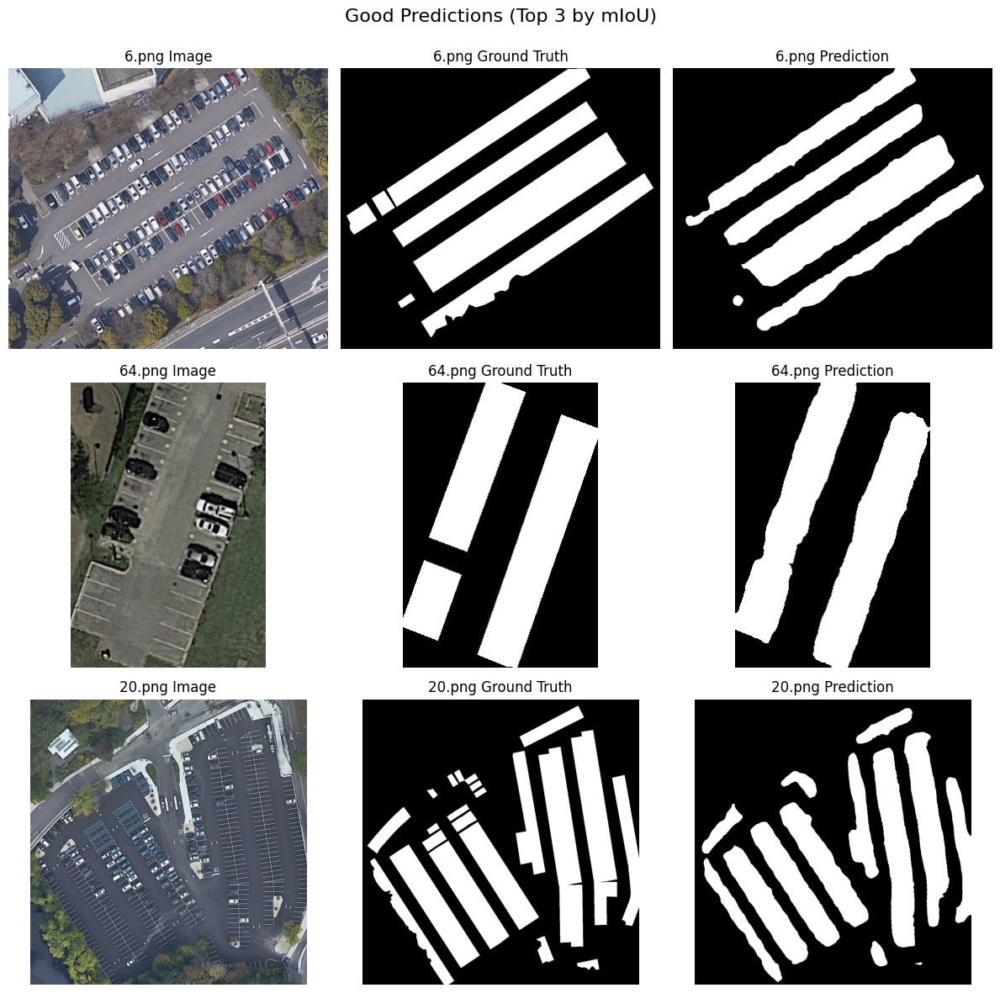

Saved: poor_predictions.png


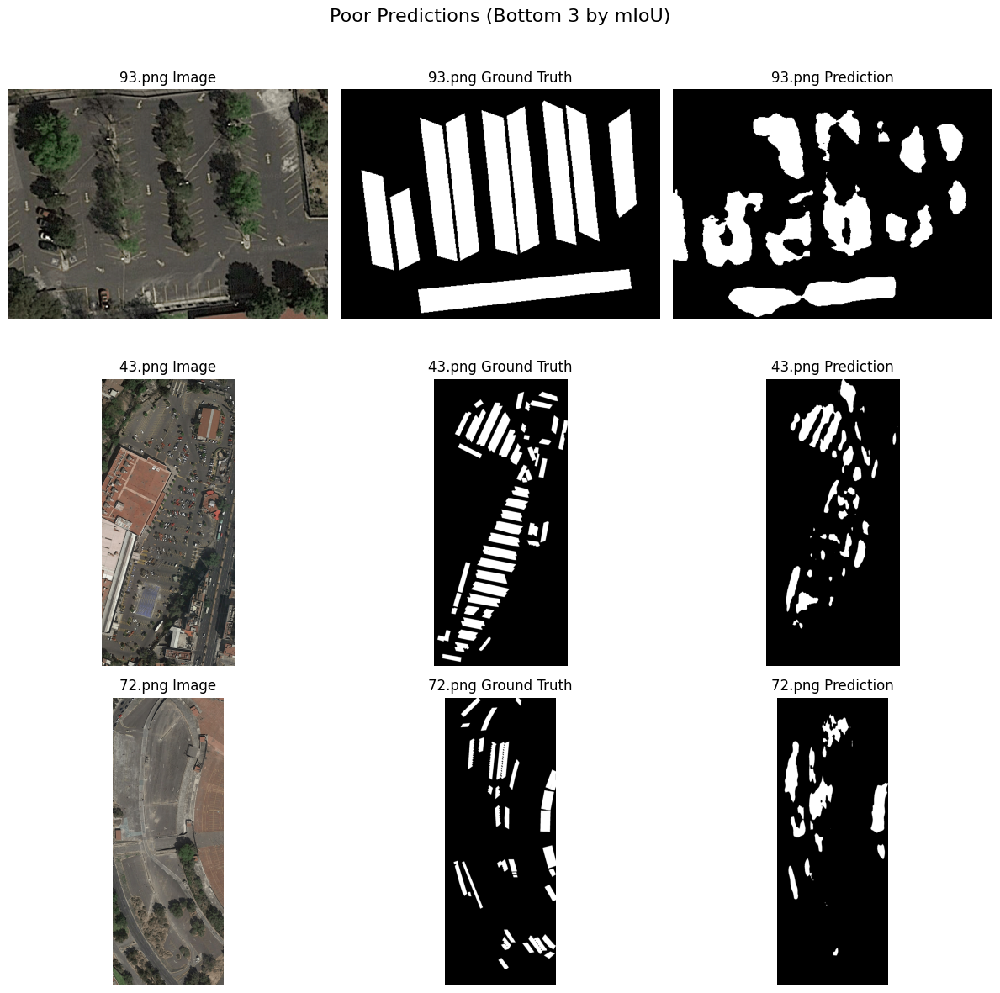

In [154]:
import matplotlib.pyplot as plt
import os
from PIL import Image
import numpy as np
import torch

def predict_mask(model, processor, image_path):
    image = Image.open(image_path).convert("RGB")
    dummy_mask = Image.new("L", image.size, color=0)
    processed = processor(image, dummy_mask, return_tensors="pt")
    pixel_values = processed["pixel_values"].to(model.device)

    with torch.no_grad():
        outputs = model(pixel_values=pixel_values)
        logits = outputs.logits
        logits = torch.nn.functional.interpolate(
            logits, size=image.size[::-1], mode="bilinear", align_corners=False
        )
        pred_mask = torch.argmax(logits, dim=1).squeeze(0).cpu().numpy()
    return pred_mask

def plot_examples(example_list, figure_title, save_path=None):
    num_examples = len(example_list)
    fig, axs = plt.subplots(num_examples, 3, figsize=(12, 4 * num_examples))

    if num_examples == 1:
        axs = np.expand_dims(axs, axis=0)

    for row_idx, (img_name, metrics) in enumerate(example_list):
        img_path = os.path.join(image_folder, img_name)
        mask_path = os.path.join(mask_folder, img_name)
        pred_mask = predict_mask(best_model, processor, img_path)

        image = Image.open(img_path).convert("RGB")
        gt_mask = Image.open(mask_path).convert("L")

        axs[row_idx][0].imshow(image)
        axs[row_idx][0].set_title(f"{img_name} Image")

        axs[row_idx][1].imshow(gt_mask, cmap="gray")
        axs[row_idx][1].set_title(f"{img_name} Ground Truth")

        axs[row_idx][2].imshow(pred_mask, cmap="gray")
        axs[row_idx][2].set_title(f"{img_name} Prediction")

        for ax in axs[row_idx]:
            ax.axis("off")

    plt.suptitle(figure_title, fontsize=16)
    plt.tight_layout(rect=[0, 0, 1, 0.97])

    if save_path:
        plt.savefig(save_path, dpi=300)
        print(f"Saved: {save_path}")
    plt.show()

# Get top 3 and bottom 3 based on mIoU
sorted_by_miou = sorted(results["per_image"].items(), key=lambda x: x[1]["miou"], reverse=True)
top_examples = sorted_by_miou[:3]
bottom_examples = sorted_by_miou[-3:]

# Plot and save
plot_examples(top_examples, "Good Predictions (Top 3 by mIoU)", save_path="good_predictions.png")
plot_examples(bottom_examples, "Poor Predictions (Bottom 3 by mIoU)", save_path="poor_predictions.png")

In [146]:
with open(f'inference_outputs/12000-end.json', 'w') as f:
    json.dump(sorted_results, f, indent=2)

50440

## Combine all predictions to get top 10 parking lots

lot120.png 83046.59999999999 m^2 129884.8824
lot7842.png 89102.87999999999 m^2 106210.63295999999
lot16750.png 79045.56 m^2 90586.21176
lot10478.png 81755.27999999998 m^2 88786.23407999998
lot9085.png 71589.59999999999 m^2 85048.4448
lot7966.png 52943.03999999999 m^2 83650.00319999999
lot427.png 70605.72 m^2 83455.96104000001
lot905.png 68451.48 m^2 73927.5984
lot16035.png 46967.03999999999 m^2 73268.5824
lot1401.png 65185.92 m^2 70791.90912
lot2827.png 40956.119999999995 m^2 61598.004479999996
lot89.png 49829.4 m^2 61389.8208
lot547.png 51427.799999999996 m^2 61301.9376
lot9774.png 60757.2 m^2 60635.685600000004
lot14505.png 55118.52 m^2 59858.71272
lot13035.png 54522.0 m^2 59210.89199999999
lot14446.png 55827.35999999999 m^2 55715.705279999995
lot1541.png 41704.55999999999 m^2 55550.47391999999
lot1797.png 34898.4 m^2 54581.09760000001
lot11.png 49317.84 m^2 53559.17424
lot12042.png 33078.24 m^2 51734.367360000004
lot12410.png 34377.119999999995 m^2 51703.18847999999
lot7336.png 3688

/tmp/ipykernel_2366/3507499491.py:31: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axes = plt.subplots(1, 3 if test_masks else 2, figsize=(12, 4))


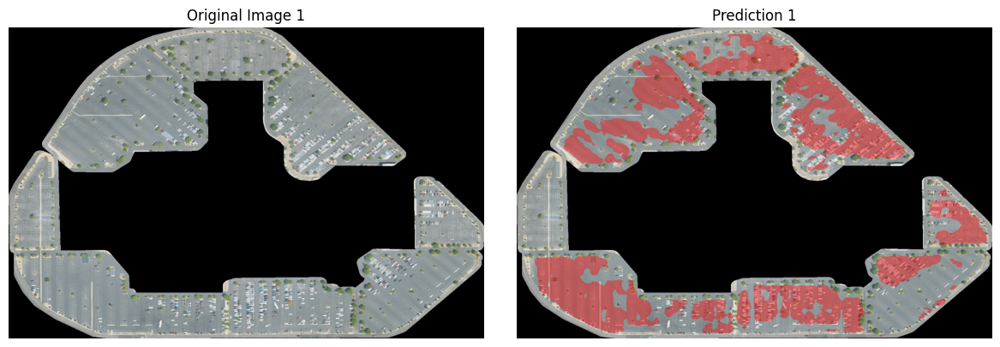

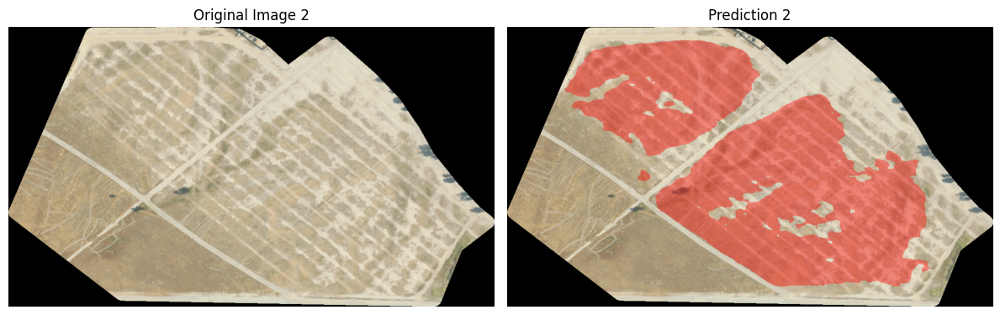

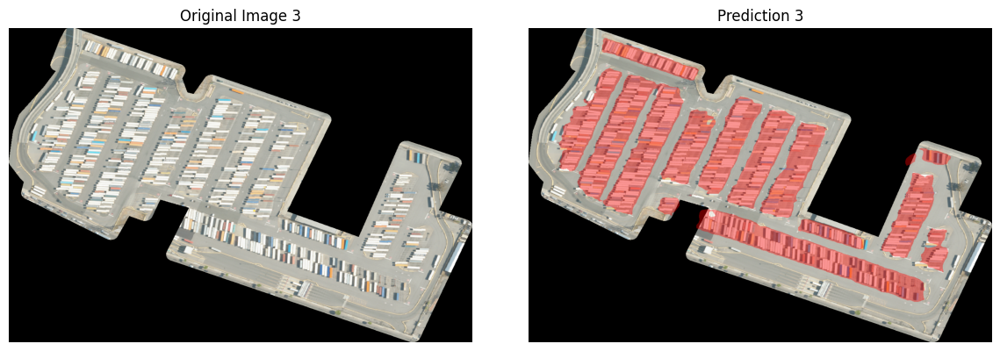

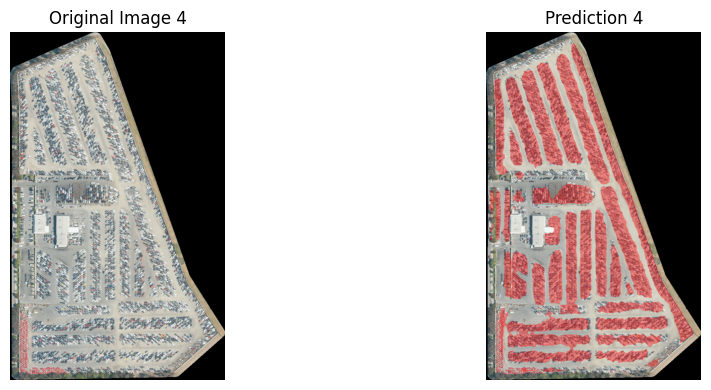

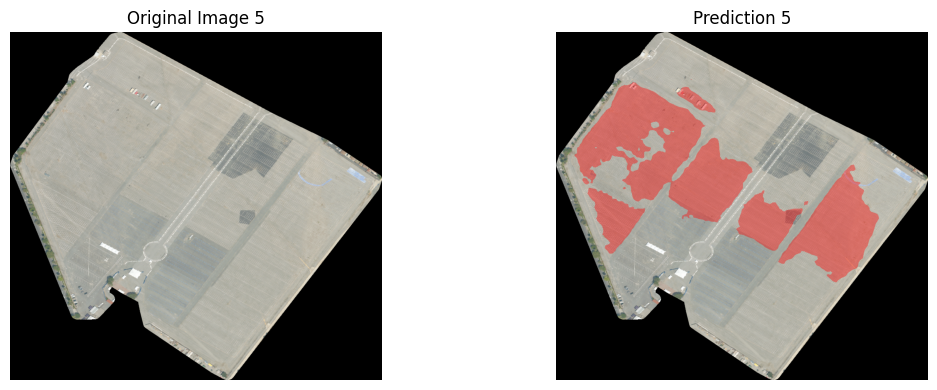

...

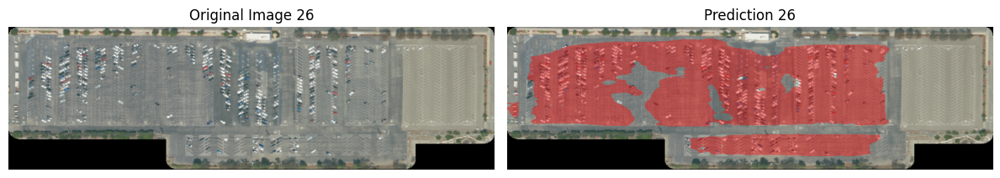

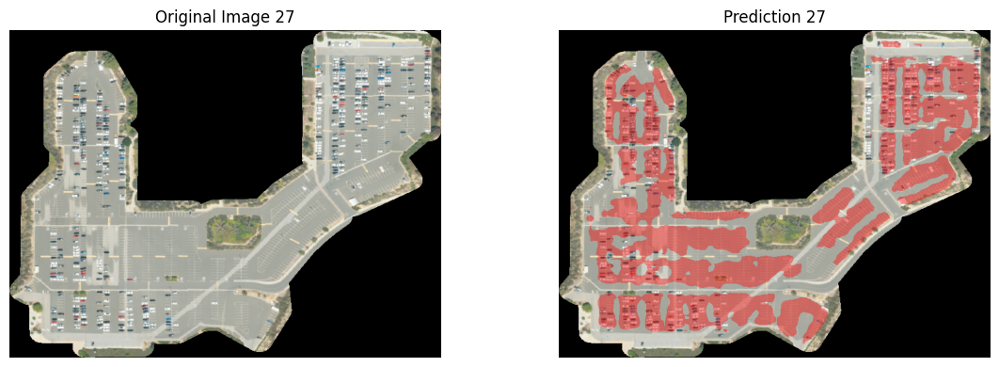

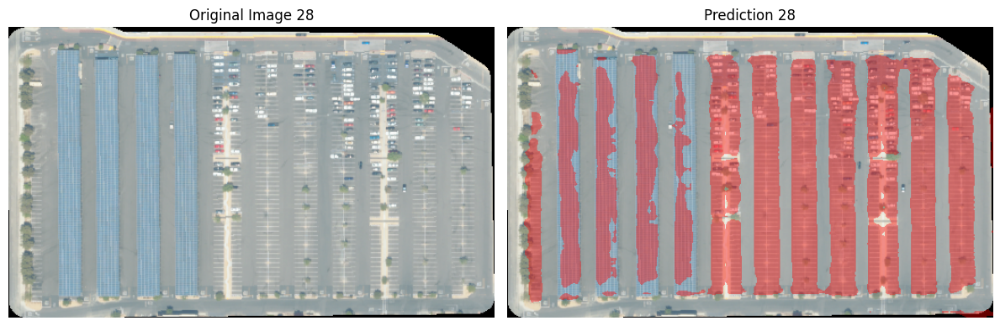

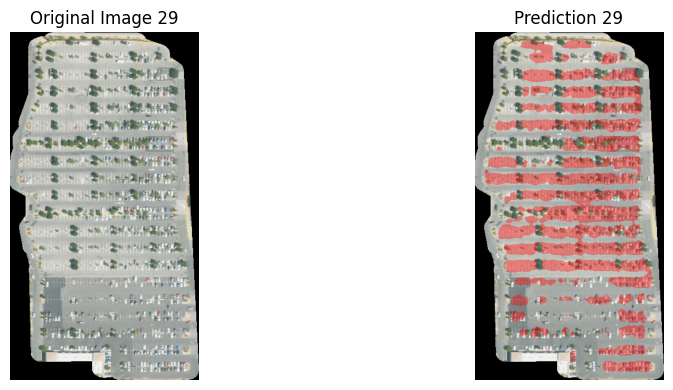

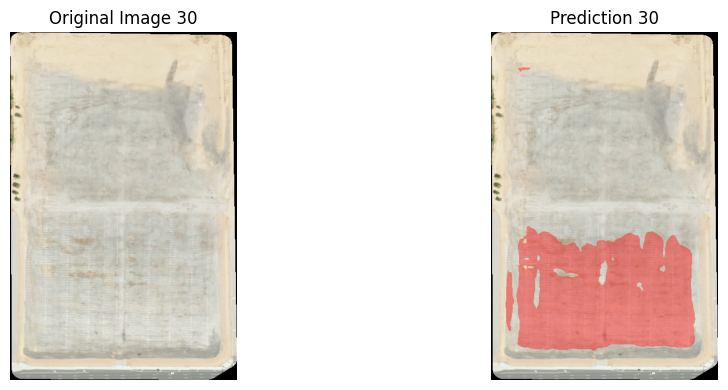

In [62]:
first_6000 = {}
second_6000 = {}
third_6000 = {}
image_folder = "/home/ubuntu/CS231N/inference_images"

from itertools import islice

with open('inference_outputs/first_6000.json') as f:
    first_6000 = json.load(f)

with open('inference_outputs/6000-12000.json') as f:
    second_6000 = json.load(f)

with open('inference_outputs/12000-end.json') as f:
    third_6000 = json.load(f)

first_10 = dict(islice(first_6000.items(), 10)) 
second_10 = dict(islice(second_6000.items(), 10)) 
third_10 = dict(islice(third_6000.items(), 10)) 

all_30 = first_10 | second_10 | third_10

sorted_30 = dict(sorted(all_30.items(), key=lambda x: x[1]["predicted_solar_irradiance"], reverse=True))

top_10 = sorted_30

top_10_list = []
for img_name in top_10.keys():
    print(img_name, top_10[img_name]['predicted_area'], "m^2", top_10[img_name]['predicted_solar_irradiance'])
    img_path = os.path.join(image_folder, img_name)
    try:
        img = Image.open(img_path).convert("RGB")
        top_10_list.append(img)
    except Exception as e:
        print(f"Could not open {img_name}: {e}")

plts = visualize_individual_predictions(best_model, processor, top_10_list, num_samples=30)
for i, plt in enumerate(plts):
    plt.savefig(f"top{i + 1}.png", dpi=300, bbox_inches='tight')

### Visualize random 20 parking lots

lot9549.png 203.75999999999996 m^2 261.62784


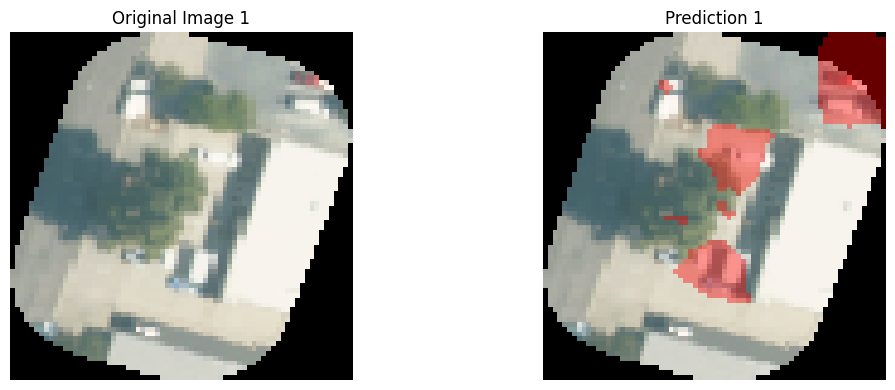

In [75]:
first_6000 = {}
second_6000 = {}
third_6000 = {}
image_folder = "/home/ubuntu/CS231N/inference_images"

from itertools import islice
import random

with open('inference_outputs/first_6000.json') as f:
    first_6000 = json.load(f)

with open('inference_outputs/6000-12000.json') as f:
    second_6000 = json.load(f)

with open('inference_outputs/12000-end.json') as f:
    third_6000 = json.load(f)

all_images = first_6000 | second_6000 | third_6000

random_20 = dict(random.sample(list(all_images.items()), 20))

random_20_list = []
for img_name in random_20.keys():
    print(img_name, random_20[img_name]['predicted_area'], "m^2", random_20[img_name]['predicted_solar_irradiance'])
    img_path = os.path.join(image_folder, img_name)
    try:
        img = Image.open(img_path).convert("RGB")
        random_20_list.append(img)
    except Exception as e:
        print(f"Could not open {img_name}: {e}")

plts = visualize_individual_predictions(best_model, processor, random_20_list, num_samples=1)
for i, plt in enumerate(plts):
    plt.savefig(f"bad{i + 1}.png", dpi=300, bbox_inches='tight')

### Visualize top 10 areas without prediction (based off area given by GEE)

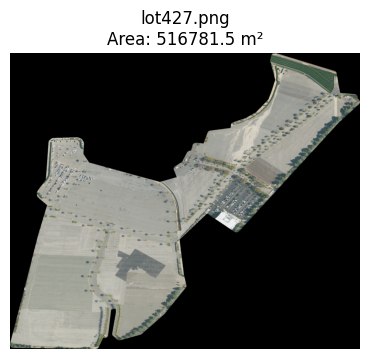

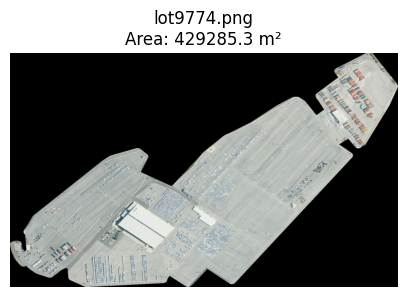

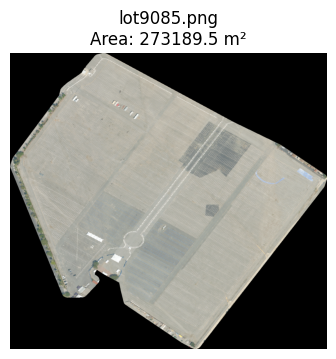

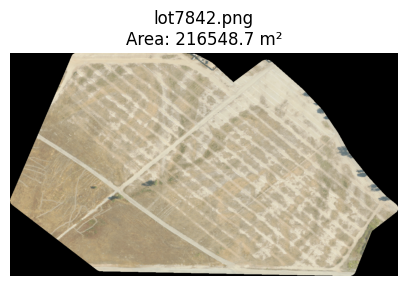

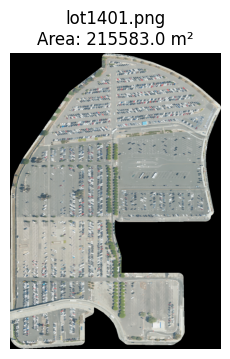

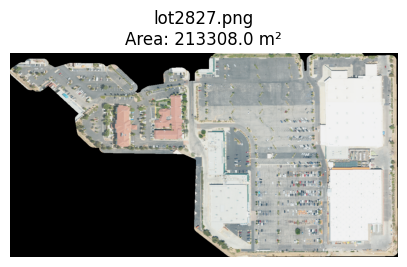

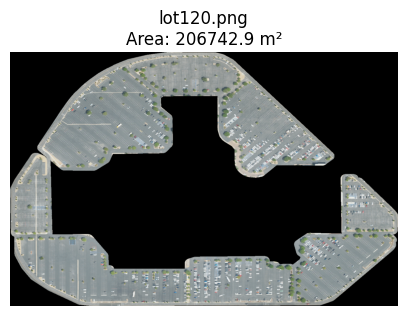

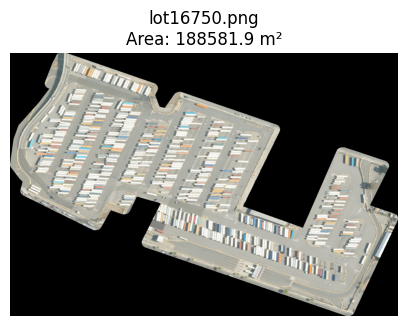

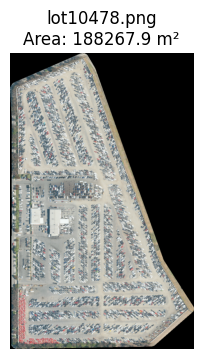

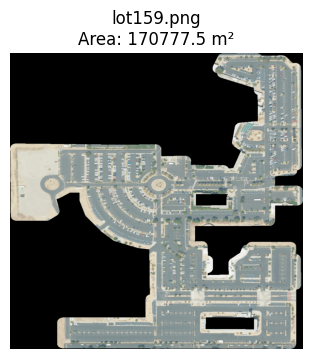

In [55]:
json_path = "solar_irradiance_results.json" 

# Load JSON data
with open(json_path, "r") as f:
    data = json.load(f)

# Sort by area, descending
top_10 = sorted(data.items(), key=lambda x: x[1]["area"], reverse=True)[:10]

# Display images
# fig, axes = plt.subplots(2, 5, figsize=(20, 8))  # 2 rows, 5 columns
# axes = axes.flatten()

for idx, (filename, info) in enumerate(top_10):
    image_path = os.path.join(image_folder, filename)
    try:
        img = Image.open(image_path).convert("RGB")
        fig, ax = plt.subplots(figsize=(5, 4))
        ax.imshow(img)
        title_text = f"{filename}\nArea: {info['area']:.1f} m²"
        ax.set_title(title_text, fontsize=12)
        ax.axis("off")
        fig.subplots_adjust(top=0.85)  # Avoid clipping title
        fig.savefig(f"top{idx + 1}_fromjustarea.png", dpi=300, bbox_inches='tight')
    except Exception as e:
        print(f"⚠️ Could not open {filename}: {e}")
        axes[idx].axis("off")
        axes[idx].set_title(f"{filename}\n⚠️ Error", fontsize=10)
# plt.tight_layout()
# plt.show()
# plt.savefig("top10fromjustarea.png", dpi=300, bbox_inches='tight')